# Striping sweep diagnostics (PRISMA vs EnMAP)

Column-wise striping scan on homogeneous calibration scenes. Sweeps wavelengths, measures FFT stripe peak strength and column variability, then summarises per sensor. Uses the same PRISMA/EnMAP test scenes as other notebooks.


## What this notebook does
- Compare PRISMA vs EnMAP striping using three complementary metrics: (1) scene-based striping amplitude as % of signal (robust MAD on high-pass residual), (2) adjacent-band ratio amplitude to suppress scene texture, (3) FFT periodicity of the column/row offset vector.
- Sweep overlapping wavelengths with optional methane windows (~1650, ~2300 nm), ROI/edge crop, and both periodic and non-periodic checks.
- Summaries, plots, and worst-band diagnostics (raw, residual, column offsets, FFT) so you can spot instrument-driven striping and scene-agnostic artefacts.


## Metrics guide (tables and plots)
- `band_nm` / `target_nm`: actual band vs requested target.
- **Scene-based amplitude**: `scene_col_amp_pct`, `scene_row_amp_pct` = 100 * 1.4826 * MAD(column/row offsets of high-pass residual) / median(scene). High = stronger striping in that direction.
- **Ratio-based amplitude**: `ratio_col_amp_pct`, `ratio_row_amp_pct` computed on adjacent-band ratios (skips if Δλ > MAX_RATIO_DWL_NM). Suppresses scene structure; high values imply detector pattern rather than surface texture.
- **FFT periodicity**: `fft_col_peak_db`, `fft_col_peak_freq_cyc_per_px`, `fft_col_energy_ratio`, `fft_col_peak_prominence_db` (row equivalents if enabled) from the column-offset vector. High dB/energy_ratio + stable freq = periodic striping.
- **Legacy metrics** (kept for continuity): `legacy_stripe_peak_db`, `legacy_stripe_peak_freq_cyc_per_px`, `legacy_column_std_ratio`, `legacy_global_std`.
- Summary table fields: medians and p90 for scene/ratio amplitudes and FFT metrics per sensor; legacy percentiles follow after.
- Plots: point curves are per-band values; “rolling median” smooths trends. CH4-window plots restrict to methane windows; spans highlight the window.
- Worst-band tables/plots: list top-N bands per metric; show raw and residual images, column offset vectors, and FFT power with the detected peak.


## Theoretical background (striping diagnostics)
- **Source of striping**: Pushbroom imagers use column-aligned detectors. Gain/offset drifts per detector introduce column biases; if they repeat by module/readout, the pattern becomes quasi-periodic.
- **Scene-based amplitude**: Remove scene structure with a low-pass filter, take the residual, then median-compress along columns/rows. A robust MAD (scaled) on that offset vector, normalised by scene median, yields striping amplitude as % of signal.
- **Ratio-based amplitude**: Adjacent-band ratios suppress surface texture; applying the same MAD metric on the ratio residual highlights detector artefacts even in textured scenes. Ratios are skipped when Δλ is large.
- **FFT periodicity**: FFT of the column-offset vector (Hann-windowed, DC suppressed) exposes narrowband periodic striping. Peak dB/energy ratio quantify strength; peak frequency gives the stripe period (cycles/pixel).
- **Assumptions**: (1) stripes are column-oriented; row metrics are optional. (2) scenes are homogeneous so residuals reflect instrument effects. (3) low-signal bands can inflate noise—guarded by valid-fraction and median-signal checks. (4) Edge/ROI cropping keeps optional control.
- **Methane windows**: Around ~1650 nm and ~2300 nm, atmospheric absorption lowers signal, which can exaggerate apparent striping. Focus plots assess whether detector artefacts could bias CH4 retrievals.


## Periodic vs non-periodic striping checks
- **Periodic detection (FFT)**: `fft_col_peak_db`, `fft_col_energy_ratio`, `fft_col_peak_freq_cyc_per_px`, `fft_col_peak_prominence_db` quantify repeating stripe modes from the column-offset vector. High dB/energy + stable frequency → instrument/readout periodicity.
- **Non-periodic detection (offset variance)**: `scene_col_amp_pct`/`scene_row_amp_pct` capture column/row biases on the high-pass residual; `ratio_col_amp_pct` adds a scene-suppressed view via adjacent-band ratios. High % means strong per-detector offsets even without a narrow frequency.
- **How the notebook uses both**: Every band records both families; summaries and plots show them side by side; worst-band tables list scene, ratio, and FFT metrics together.
- **Interpreting combinations**:
  - High FFT + high scene/ratio amplitude → periodic striping tied to detector blocks/readout cadence.
  - Low FFT but high scene/ratio amplitude → non-periodic column bias or calibration drift.
  - High FFT but modest amplitude → narrow periodic stripe on otherwise uniform columns.
  - Both low → negligible striping (or band too low-signal if checks masked values).


## Setup
- Locate repository root and add to `PYTHONPATH`
- Configure plotting defaults


In [4]:
import os
import sys
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

NOTEBOOK_ROOT = Path.cwd().resolve()
REPO_ROOT = NOTEBOOK_ROOT
while not (REPO_ROOT / "scripts").exists() and REPO_ROOT.parent != REPO_ROOT:
    REPO_ROOT = REPO_ROOT.parent
if not (REPO_ROOT / "scripts").exists():
    raise RuntimeError("Could not locate repository root containing scripts directory.")

os.environ.setdefault("PYTHONPATH", str(REPO_ROOT))
if str(REPO_ROOT) not in sys.path:
    sys.path.insert(0, str(REPO_ROOT))

plt.style.use("seaborn-v0_8-colorblind")
pd.set_option("display.max_rows", 20)
pd.set_option("display.max_columns", 20)

print(f"Notebook root: {NOTEBOOK_ROOT}")
print(f"Repository root: {REPO_ROOT}")


Notebook root: /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks
Repository root: /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas


## Configuration
Adjust wavelength sweep density or restrict to a manual list. ROIs stay optional because scenes are homogeneous.


In [5]:
from typing import Dict, List, Optional

STRIPE_TARGET_MODE = "grid"  # "grid" to sweep, "manual" to use MANUAL_TARGETS_NM
GRID_STEP_NM = 10.0           # wavelength spacing for grid mode
MANUAL_TARGETS_NM: List[float] = [1250.0, 1650.0, 2200.0]
MAX_TARGETS: Optional[int] = None  # cap number of targets; None = no cap

EDGE_CROP_COLS = 0            # drop this many columns on each side

HPF_METHOD = "gaussian"    # "gaussian" or "box" for low-pass
GAUSS_SIGMA_PX = 10.0
BOX_KERNEL_PX = 31
MIN_VALID_FRACTION = 0.95      # require this fraction of finite pixels in ROI
MIN_FREQ_CYC_PER_PX = 1.0 / 256.0
PEAK_HALF_WIDTH_BINS = 1
MAX_RATIO_DWL_NM = 20.0        # skip ratio metric if adjacent band spacing exceeds this
COMPUTE_ROW_METRICS = True     # also compute row-wise metrics
NORMALISE_BY = "median"       # keep median normalisation
RATIO_EPS = 1e-6
LOW_STD_EPS = 1e-6
Z_THRESH_PRIMARY = 6.0
Z_THRESH_SECONDARY = 4.0

SAVE_FIGURES = True
SCENE_SET = "cal"
OUTPUTS_DIR = NOTEBOOK_ROOT / "outputs_cal_scenes"
TABLE_DIR = OUTPUTS_DIR
FIG_DIR = OUTPUTS_DIR / "figures"
PAPER_FIG_DIR = NOTEBOOK_ROOT / "outputs" / "paper_figs" / SCENE_SET
RUN_CONFIG_PATH = OUTPUTS_DIR / "run_config.json"

SCENE_CONFIG: Dict[str, Dict[str, object]] = {
    "enmap": {
        "name": "enmap",
        "scene_id": "L1B-DT0000001584_20220712T104302Z_001_V010502_20251017T093724Z",
        "data_dir": REPO_ROOT
        / "test_data"
        / "enmap"
        / "Agadez_Niger_20220712"
        / "L1B-DT0000001584_20220712T104302Z_001_V010502_20251017T093724Z",
        "striping_roi": None,
    },
    "prisma": {
        "name": "prisma",
        "scene_id": "20200401085313",
        "l1_path": REPO_ROOT
        / "test_data"
        / "prisma"
        / "Northern_State_Sudan_20200401"
        / "20200401085313_20200401085318"
        / "PRS_L1_STD_OFFL_20200401085313_20200401085318_0001.zip",
        "l2_path": REPO_ROOT
        / "test_data"
        / "prisma"
        / "Northern_State_Sudan_20200401"
        / "20200401085313_20200401085318"
        / "PRS_L2C_STD_20200401085313_20200401085318_0001.zip",
        "striping_roi": None,
    },
}

CH4_WINDOWS = {
    "CH4_1650 (1600–1700 nm)": (1600.0, 1800.0),
    "CH4_2300 (2200–2350 nm)": (2150.0, 2450.0),
}
EXTRA_WINDOWS = {
}


In [6]:

# Paper figure settings
PAPER_FIGURES = True
SAVE_FIGURES = True
PAPER_FIG_DIR = NOTEBOOK_ROOT / 'outputs' / 'paper_figs' / 'cal'
PAPER_FIG_DIR.mkdir(parents=True, exist_ok=True)

import matplotlib as mpl
mpl.rcParams.update({
    'font.size': 10,
    'axes.titlesize': 11,
    'axes.labelsize': 10,
    'legend.fontsize': 9,
})

def save_paper_fig(fig, path_base):
    path_base.parent.mkdir(parents=True, exist_ok=True)
    fig.savefig(f"{path_base}.png", dpi=300, bbox_inches='tight')
    fig.savefig(f"{path_base}.pdf", dpi=300, bbox_inches='tight')
    print(f"Saved {path_base}.png/.pdf")

def add_panel_label(ax, label, x=0.01, y=0.98):
    ax.text(x, y, label, transform=ax.transAxes, fontsize=11, fontweight='bold', va='top')

def shared_percentile_limits(arrays, p_lo=2, p_hi=98):
    vals = []
    for arr in arrays:
        if arr is None:
            continue
        arr_flat = arr[np.isfinite(arr)]
        if arr_flat.size:
            vals.append(arr_flat)
    if not vals:
        return None
    import numpy as _np
    concat = _np.concatenate(vals)
    return tuple(_np.percentile(concat, [p_lo, p_hi]))


## Run parameters snapshot
Captured for reproducibility and saved to `run_config.json` alongside outputs.

In [7]:
import json
from datetime import datetime

OUTPUTS_DIR.mkdir(parents=True, exist_ok=True)
FIG_DIR.mkdir(parents=True, exist_ok=True)

run_config = {
    "stripe_target_mode": STRIPE_TARGET_MODE,
    "grid_step_nm": GRID_STEP_NM,
    "manual_targets_nm": MANUAL_TARGETS_NM,
    "max_targets": MAX_TARGETS,
    "edge_crop_cols": EDGE_CROP_COLS,
    "hpf_method": HPF_METHOD,
    "gauss_sigma_px": GAUSS_SIGMA_PX,
    "box_kernel_px": BOX_KERNEL_PX,
    "min_valid_fraction": MIN_VALID_FRACTION,
    "min_freq_cyc_per_px": MIN_FREQ_CYC_PER_PX,
    "peak_half_width_bins": PEAK_HALF_WIDTH_BINS,
    "max_ratio_dwl_nm": MAX_RATIO_DWL_NM,
    "compute_row_metrics": COMPUTE_ROW_METRICS,
    "normalise_by": NORMALISE_BY,
    "ratio_eps": RATIO_EPS,
    "low_std_eps": LOW_STD_EPS,
    "save_figures": SAVE_FIGURES,
    "striping_roi_enmap": SCENE_CONFIG["enmap"].get("striping_roi"),
    "striping_roi_prisma": SCENE_CONFIG["prisma"].get("striping_roi"),
    "ch4_windows": CH4_WINDOWS,
    "timestamp_utc": datetime.utcnow().isoformat() + "Z",
}

print("Run configuration:")
for k, v in run_config.items():
    print(f"  {k}: {v}")

with open(RUN_CONFIG_PATH, "w") as f:
    json.dump(run_config, f, indent=2, sort_keys=True)
print(f"Saved run config to {RUN_CONFIG_PATH}")


Run configuration:
  stripe_target_mode: grid
  grid_step_nm: 10.0
  manual_targets_nm: [1250.0, 1650.0, 2200.0]
  max_targets: None
  edge_crop_cols: 0
  hpf_method: gaussian
  gauss_sigma_px: 10.0
  box_kernel_px: 31
  min_valid_fraction: 0.95
  min_freq_cyc_per_px: 0.00390625
  peak_half_width_bins: 1
  max_ratio_dwl_nm: 20.0
  compute_row_metrics: True
  normalise_by: median
  ratio_eps: 1e-06
  low_std_eps: 1e-06
  save_figures: True
  striping_roi_enmap: None
  striping_roi_prisma: None
  ch4_windows: {'CH4_1650 (1600–1700 nm)': (1600.0, 1800.0), 'CH4_2300 (2200–2350 nm)': (2150.0, 2450.0)}
  timestamp_utc: 2025-12-22T22:03:36.299997Z
Saved run config to /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs_cal_scenes/run_config.json


## Run metadata
Print the saved run_config.json for audit.

In [8]:
import json

try:
    with open(RUN_CONFIG_PATH, "r") as f:
        cfg_loaded = json.load(f)
    print(json.dumps(cfg_loaded, indent=2, sort_keys=True))
except FileNotFoundError:
    print("run_config.json not found; run the parameter snapshot cell first.")


{
  "box_kernel_px": 31,
  "ch4_windows": {
    "CH4_1650 (1600\u20131700 nm)": [
      1600.0,
      1800.0
    ],
    "CH4_2300 (2200\u20132350 nm)": [
      2150.0,
      2450.0
    ]
  },
  "compute_row_metrics": true,
  "edge_crop_cols": 0,
  "gauss_sigma_px": 10.0,
  "grid_step_nm": 10.0,
  "hpf_method": "gaussian",
  "low_std_eps": 1e-06,
  "manual_targets_nm": [
    1250.0,
    1650.0,
    2200.0
  ],
  "max_ratio_dwl_nm": 20.0,
  "max_targets": null,
  "min_freq_cyc_per_px": 0.00390625,
  "min_valid_fraction": 0.95,
  "normalise_by": "median",
  "peak_half_width_bins": 1,
  "ratio_eps": 1e-06,
  "save_figures": true,
  "stripe_target_mode": "grid",
  "striping_roi_enmap": null,
  "striping_roi_prisma": null,
  "timestamp_utc": "2025-12-22T22:03:36.299997Z"
}


## Helpers
Scene loading and basic utilities reused from earlier notebooks.


In [9]:
from functools import lru_cache
from pathlib import Path
from typing import Any, Mapping, Sequence, Tuple

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from scripts.diagnostics import striping

try:
    from scipy.ndimage import gaussian_filter, uniform_filter
except Exception:
    gaussian_filter = None
    uniform_filter = None

EPS = 1e-9


def nanmad(v: np.ndarray) -> float:
    med = np.nanmedian(v)
    return float(np.nanmedian(np.abs(v - med)))


def run_lengths(mask: np.ndarray) -> Tuple[int, int, float, list]:
    runs = []
    start = None
    for i, flag in enumerate(mask.astype(bool)):
        if flag and start is None:
            start = i
        if (not flag or i == len(mask) - 1) and start is not None:
            end = i if not flag else i
            runs.append((start, end))
            start = None
    if not runs:
        return 0, 0, 0.0, []
    lengths = [e - s + 1 for s, e in runs]
    n_runs = len(runs)
    max_run = int(np.max(lengths))
    mean_run = float(np.mean(lengths))
    return n_runs, max_run, mean_run, runs


def savefig(path, fig=None, dpi=300):
    (fig or plt.gcf()).savefig(path, dpi=dpi, bbox_inches="tight")


def parse_roi(spec: Optional[str], rows: int, cols: int) -> Optional[Tuple[slice, slice]]:
    if spec is None:
        return None
    try:
        x_part, y_part = spec.split(",")
        x0, x1 = [int(v) for v in x_part.split(":")]
        y0, y1 = [int(v) for v in y_part.split(":")]
    except Exception as exc:
        raise ValueError("ROI must follow 'x0:x1,y0:y1' (cols,rows)") from exc
    if not (0 <= x0 < x1 <= cols and 0 <= y0 < y1 <= rows):
        raise ValueError(f"ROI {spec} outside bounds (rows={rows}, cols={cols})")
    return slice(y0, y1), slice(x0, x1)


def apply_roi_and_crop(img: np.ndarray, roi_spec: Optional[str], edge_crop_cols: int = 0) -> np.ndarray:
    arr = img.astype(float)
    rows, cols = arr.shape
    if roi_spec:
        roi = parse_roi(roi_spec, rows, cols)
        arr = arr[roi[0], roi[1]]
        rows, cols = arr.shape
    if edge_crop_cols > 0 and edge_crop_cols * 2 < cols:
        arr = arr[:, edge_crop_cols:-edge_crop_cols]
    return arr


def ensure_directory(path: Path) -> Path:
    path = Path(path)
    if not path.exists():
        raise FileNotFoundError(path)
    return path


def _resolve_prisma_he5(path: Path) -> Path:
    path = Path(path).expanduser().resolve()
    if not path.exists():
        raise FileNotFoundError(path)
    if path.suffix.lower() == ".zip":
        from scripts.satellites import prisma_utils

        extracted = prisma_utils.extract_he5_from_zip(str(path), str(path.parent))
        if extracted is None:
            raise FileNotFoundError(f"No .he5 found inside {path}")
        return Path(extracted).resolve()
    return path


def _load_prisma(cfg: Mapping[str, object]) -> Dict[str, Any]:
    from scripts.satellites import prisma_utils

    he5_path = _resolve_prisma_he5(Path(cfg["l1_path"]))
    cube, cw_matrix, fwhm_matrix, *_ = prisma_utils.prisma_read(str(he5_path))
    cube_brc = np.transpose(cube, (2, 0, 1)).astype(np.float32)
    cw_matrix = np.asarray(cw_matrix, dtype=np.float64)
    wavelengths = np.nanmean(cw_matrix, axis=0)
    return {
        "cube_brc": cube_brc,
        "cw_matrix": cw_matrix,
        "fwhm_matrix": np.asarray(fwhm_matrix, dtype=np.float64),
        "wavelengths": wavelengths,
        "he5_path": he5_path,
    }


def _load_enmap(cfg: Mapping[str, object]) -> Dict[str, Any]:
    from scripts.satellites import enmap_utils

    data_dir = ensure_directory(Path(cfg["data_dir"]).expanduser())
    vnir_path, swir_path, xml_path = enmap_utils.find_enmap_files(str(data_dir))
    cube, cw_vec, fwhm_vec, *_ = enmap_utils.enmap_read(vnir_path, swir_path, xml_path)
    cube_brc = np.transpose(cube, (2, 0, 1)).astype(np.float32)
    vnir_meta, swir_meta = enmap_utils.parse_metadata_vnir_swir(xml_path)
    return {
        "cube_brc": cube_brc,
        "wavelengths": np.asarray(cw_vec, dtype=np.float64),
        "fwhm": np.asarray(fwhm_vec, dtype=np.float64),
        "vnir_meta": vnir_meta,
        "swir_meta": swir_meta,
        "xml_path": Path(xml_path),
    }


SCENE_DATA_CACHE: Dict[str, Dict[str, Any]] = {}


@lru_cache(maxsize=4)
def load_scene(sensor: str) -> Dict[str, Any]:
    sensor = sensor.lower()
    if sensor in SCENE_DATA_CACHE:
        return SCENE_DATA_CACHE[sensor]
    cfg = SCENE_CONFIG[sensor]
    if sensor == "prisma":
        data = _load_prisma(cfg)
    elif sensor == "enmap":
        data = _load_enmap(cfg)
    else:
        raise KeyError(sensor)
    SCENE_DATA_CACHE[sensor] = data
    return data


def lowpass(img: np.ndarray, method: str = HPF_METHOD, sigma_px: float = GAUSS_SIGMA_PX, box_kernel_px: int = BOX_KERNEL_PX) -> np.ndarray:
    arr = np.asarray(img, dtype=float)
    mask = np.isfinite(arr)
    if not mask.any():
        return np.full_like(arr, np.nan, dtype=float)
    arr0 = np.where(mask, arr, 0.0)

    if method == "gaussian" and gaussian_filter is not None:
        val = gaussian_filter(arr0, sigma=sigma_px, mode="nearest")
        weight = gaussian_filter(mask.astype(float), sigma=sigma_px, mode="nearest")
    else:
        k = int(max(1, box_kernel_px))
        if k % 2 == 0:
            k += 1
        if uniform_filter is not None:
            val = uniform_filter(arr0, size=k, mode="nearest") * (k**2)
            weight = uniform_filter(mask.astype(float), size=k, mode="nearest") * (k**2)
        else:
            pad = k // 2
            arr_pad = np.pad(arr0, pad_width=pad, mode="constant", constant_values=0.0)
            mask_pad = np.pad(mask.astype(float), pad_width=pad, mode="constant", constant_values=0.0)
            csum = arr_pad.cumsum(axis=0).cumsum(axis=1)
            ccount = mask_pad.cumsum(axis=0).cumsum(axis=1)
            val = csum[k:, k:] - csum[:-k, k:] - csum[k:, :-k] + csum[:-k, :-k]
            weight = ccount[k:, k:] - ccount[:-k, k:] - ccount[k:, :-k] + ccount[:-k, :-k]
    lpf = np.where(weight > 0, val / np.clip(weight, EPS, None), np.nan)
    return lpf


def highpass(img: np.ndarray, **kwargs) -> np.ndarray:
    lpf = lowpass(img, **kwargs)
    return img - lpf


def robust_striping_amplitude(
    img: np.ndarray,
    axis: str = "col",
    normalise_by: str = NORMALISE_BY,
    return_vector: bool = False,
    return_residual: bool = False,
    **lpf_kwargs,
) -> Dict[str, Any]:
    resid = highpass(img, **lpf_kwargs)
    if axis == "col":
        m_vec = np.nanmedian(resid, axis=0)
    elif axis == "row":
        m_vec = np.nanmedian(resid, axis=1)
    else:
        raise ValueError("axis must be 'col' or 'row'")
    mad = nanmad(m_vec)
    if normalise_by == "median":
        denom = np.nanmedian(img)
    else:
        denom = np.nanmean(img)
    if not np.isfinite(denom) or abs(denom) < EPS:
        amp_pct = np.nan
    else:
        amp_pct = 100.0 * 1.4826 * mad / denom
    out = {"amp_pct": float(amp_pct)}
    if return_vector:
        out["m_vector"] = m_vec
    if return_residual:
        out["residual"] = resid
    return out


def fft_periodic_metrics(vec: np.ndarray, min_freq: float = MIN_FREQ_CYC_PER_PX, half_width_bins: int = PEAK_HALF_WIDTH_BINS, prominence_window: int = 3) -> Dict[str, float]:
    v = np.asarray(vec, dtype=float)
    mask = np.isfinite(v)
    if v.size < 2 or not mask.any():
        return {"peak_db": np.nan, "peak_freq": np.nan, "energy_ratio": np.nan, "prominence_db": np.nan}
    fill_value = float(np.nanmedian(v)) if mask.any() else 0.0
    v_filled = np.where(mask, v, fill_value)
    v_centered = v_filled - np.nanmedian(v_filled)
    window = np.hanning(v_centered.size)
    fft_vals = np.fft.rfft(v_centered * window)
    power = np.abs(fft_vals) ** 2
    freqs = np.fft.rfftfreq(v_centered.size, d=1.0)
    valid = freqs >= max(min_freq, 0.0)
    if valid.size > 0:
        valid[0] = False
    if not valid.any():
        return {"peak_db": np.nan, "peak_freq": np.nan, "energy_ratio": np.nan, "prominence_db": np.nan}
    power_valid = power[valid]
    freqs_valid = freqs[valid]
    if power_valid.size == 0:
        return {"peak_db": np.nan, "peak_freq": np.nan, "energy_ratio": np.nan, "prominence_db": np.nan}
    baseline = np.nanmedian(power_valid) + EPS
    peak_idx_valid = int(np.nanargmax(power_valid))
    peak_power = float(power_valid[peak_idx_valid])
    peak_freq = float(freqs_valid[peak_idx_valid])
    peak_db = 10.0 * np.log10(peak_power / baseline) if peak_power > 0 else np.nan

    idx_full = np.nonzero(valid)[0][peak_idx_valid]
    lo = max(idx_full - half_width_bins, 0)
    hi = min(idx_full + half_width_bins + 1, power.size)
    energy_ratio = float(np.nansum(power[lo:hi]) / np.clip(np.nansum(power[valid]), EPS, None))

    prominence_db = np.nan
    if prominence_window > 0:
        excl = np.ones_like(power, dtype=bool)
        excl[lo:hi] = False
        local = power[valid & excl]
        if local.size:
            local_baseline = np.nanmedian(local) + EPS
            prominence_db = 10.0 * np.log10(peak_power / local_baseline) if peak_power > 0 else np.nan

    return {
        "peak_db": peak_db,
        "peak_freq": peak_freq,
        "energy_ratio": energy_ratio,
        "prominence_db": prominence_db,
    }


def adjacent_ratio(img_num: np.ndarray, img_den: np.ndarray, eps: float = RATIO_EPS) -> np.ndarray:
    num = np.asarray(img_num, dtype=float)
    den = np.asarray(img_den, dtype=float)
    return np.divide(num, den + eps, out=np.full_like(num, np.nan, dtype=float), where=np.isfinite(num) & np.isfinite(den))


## Target selection and per-band striping metrics
Sweeps wavelengths (grid or manual) and measures stripe peak strength with an extra local-prominence check.


In [10]:
from typing import Iterable


def build_targets(
    wavelengths: Sequence[float],
    mode: str = "grid",
    step_nm: float = GRID_STEP_NM,
    manual_targets: Optional[Iterable[float]] = None,
    wl_min: Optional[float] = None,
    wl_max: Optional[float] = None,
    max_targets: Optional[int] = None,
) -> List[float]:
    arr = np.asarray(wavelengths, dtype=float)
    wl_min = float(np.nanmin(arr)) if wl_min is None else wl_min
    wl_max = float(np.nanmax(arr)) if wl_max is None else wl_max
    if mode == "manual":
        targets = list(manual_targets or [])
    else:
        start = np.ceil(wl_min / step_nm) * step_nm
        targets = list(np.arange(start, wl_max + step_nm * 0.5, step_nm))
    targets = [float(t) for t in targets if wl_min <= t <= wl_max]
    uniq: List[float] = []
    for t in targets:
        if not any(abs(u - t) < 1e-3 for u in uniq):
            uniq.append(t)
    if max_targets is not None:
        uniq = uniq[:max_targets]
    return uniq


def nearest_band_index(wavelengths: Sequence[float], target_nm: float) -> Tuple[int, float]:
    arr = np.asarray(wavelengths, dtype=float)
    if arr.size == 0:
        raise ValueError("Empty wavelength array")
    idx = int(np.nanargmin(np.abs(arr - target_nm)))
    return idx, float(arr[idx])


def select_ratio_band(wavelengths: Sequence[float], idx: int, max_ratio_dwl_nm: float) -> Optional[int]:
    wl = np.asarray(wavelengths, dtype=float)
    if idx + 1 < wl.size and abs(wl[idx + 1] - wl[idx]) <= max_ratio_dwl_nm:
        return idx + 1
    if idx - 1 >= 0 and abs(wl[idx] - wl[idx - 1]) <= max_ratio_dwl_nm:
        return idx - 1
    return None


def compute_band_metrics(
    scene: Dict[str, Any],
    target_nm: float,
    roi_spec: Optional[str] = None,
) -> Dict[str, float]:
    cube = scene["cube_brc"]
    wavelengths = scene["wavelengths"]
    idx, band_nm = nearest_band_index(wavelengths, target_nm)
    img = cube[idx].astype(float)
    img = apply_roi_and_crop(img, roi_spec, EDGE_CROP_COLS)
    valid_mask = np.isfinite(img)
    valid_fraction = float(np.mean(valid_mask)) if valid_mask.size else 0.0

    metrics: Dict[str, float] = {
        "band_index": idx + 1,
        "band_nm": float(band_nm),
        "target_nm": float(target_nm),
        "valid_fraction": valid_fraction,
    }

    nan_fields = [
        "scene_col_amp_pct",
        "scene_row_amp_pct",
        "ratio_col_amp_pct",
        "ratio_row_amp_pct",
        "fft_col_peak_db",
        "fft_col_peak_freq_cyc_per_px",
        "fft_col_energy_ratio",
        "fft_col_peak_prominence_db",
        "fft_row_peak_db",
        "fft_row_peak_freq_cyc_per_px",
        "fft_row_energy_ratio",
        "fft_row_peak_prominence_db",
        "ratio_used_idx",
        "legacy_stripe_peak_db",
        "legacy_stripe_peak_freq_cyc_per_px",
        "legacy_column_std_ratio",
        "legacy_global_std",
        "col_outlier_pct_z6",
        "col_outlier_n_runs_z6",
        "col_outlier_max_run_z6",
        "col_outlier_pct_z4",
        "col_outlier_n_runs_z4",
        "col_outlier_max_run_z4",
    ]

    if not valid_mask.any() or valid_fraction < MIN_VALID_FRACTION:
        metrics.update({k: np.nan for k in nan_fields})
        return metrics

    median_signal = float(np.nanmedian(img))
    if abs(median_signal) < LOW_STD_EPS:
        metrics.update({k: np.nan for k in nan_fields})
        return metrics

    # Scene-based amplitude and FFT (columns / rows)
    amp_col = robust_striping_amplitude(
        img,
        axis="col",
        normalise_by=NORMALISE_BY,
        return_vector=True,
        return_residual=True,
    )
    metrics["scene_col_amp_pct"] = float(amp_col["amp_pct"])
    m_col = amp_col.get("m_vector")
    resid_col = amp_col.get("residual")

    fft_col = fft_periodic_metrics(m_col, min_freq=MIN_FREQ_CYC_PER_PX, half_width_bins=PEAK_HALF_WIDTH_BINS)
    metrics["fft_col_peak_db"] = float(fft_col.get("peak_db"))
    metrics["fft_col_peak_freq_cyc_per_px"] = float(fft_col.get("peak_freq"))
    metrics["fft_col_energy_ratio"] = float(fft_col.get("energy_ratio"))
    metrics["fft_col_peak_prominence_db"] = float(fft_col.get("prominence_db"))

    if COMPUTE_ROW_METRICS:
        amp_row = robust_striping_amplitude(
            img, axis="row", normalise_by=NORMALISE_BY, return_vector=True, return_residual=False
        )
        metrics["scene_row_amp_pct"] = float(amp_row["amp_pct"])
        m_row = amp_row.get("m_vector")
        fft_row = fft_periodic_metrics(m_row, min_freq=MIN_FREQ_CYC_PER_PX, half_width_bins=PEAK_HALF_WIDTH_BINS)
        metrics["fft_row_peak_db"] = float(fft_row.get("peak_db"))
        metrics["fft_row_peak_freq_cyc_per_px"] = float(fft_row.get("peak_freq"))
        metrics["fft_row_energy_ratio"] = float(fft_row.get("energy_ratio"))
        metrics["fft_row_peak_prominence_db"] = float(fft_row.get("prominence_db"))
    else:
        metrics["scene_row_amp_pct"] = np.nan
        metrics["fft_row_peak_db"] = np.nan
        metrics["fft_row_peak_freq_cyc_per_px"] = np.nan
        metrics["fft_row_energy_ratio"] = np.nan
        metrics["fft_row_peak_prominence_db"] = np.nan

    # Ratio-based amplitude
    ratio_idx = select_ratio_band(wavelengths, idx, MAX_RATIO_DWL_NM)
    metrics["ratio_used_idx"] = float(ratio_idx + 1) if ratio_idx is not None else np.nan
    if ratio_idx is not None:
        img_ratio = cube[ratio_idx].astype(float)
        img_ratio = apply_roi_and_crop(img_ratio, roi_spec, EDGE_CROP_COLS)
        ratio_img = adjacent_ratio(img_ratio, img, eps=RATIO_EPS)
        if np.isfinite(ratio_img).mean() >= MIN_VALID_FRACTION:
            ratio_col = robust_striping_amplitude(
                ratio_img, axis="col", normalise_by=NORMALISE_BY, return_vector=False, return_residual=False
            )
            metrics["ratio_col_amp_pct"] = float(ratio_col["amp_pct"])
            if COMPUTE_ROW_METRICS:
                ratio_row = robust_striping_amplitude(
                    ratio_img, axis="row", normalise_by=NORMALISE_BY, return_vector=False, return_residual=False
                )
                metrics["ratio_row_amp_pct"] = float(ratio_row["amp_pct"])
            else:
                metrics["ratio_row_amp_pct"] = np.nan
        else:
            metrics["ratio_col_amp_pct"] = np.nan
            metrics["ratio_row_amp_pct"] = np.nan
    else:
        metrics["ratio_col_amp_pct"] = np.nan
        metrics["ratio_row_amp_pct"] = np.nan

    # Defective column diagnostic on high-pass residual
    col_mad = np.apply_along_axis(nanmad, 0, resid_col)
    med_s = np.nanmedian(col_mad)
    mad_s = nanmad(col_mad)
    if np.isfinite(mad_s) and mad_s > 0:
        z_scores = (col_mad - med_s) / (1.4826 * mad_s + EPS)
    else:
        z_scores = np.full_like(col_mad, np.nan)

    def _outlier_stats(z, thresh):
        mask = z > thresh
        n_runs, max_run, mean_run, runs = run_lengths(mask)
        pct = float(np.nan) if mask.size == 0 else 100.0 * np.sum(mask) / mask.size
        return pct, n_runs, max_run

    pct6, nrun6, maxrun6 = _outlier_stats(z_scores, Z_THRESH_PRIMARY)
    pct4, nrun4, maxrun4 = _outlier_stats(z_scores, Z_THRESH_SECONDARY)
    metrics["col_outlier_pct_z6"] = float(pct6)
    metrics["col_outlier_n_runs_z6"] = float(nrun6)
    metrics["col_outlier_max_run_z6"] = float(maxrun6)
    metrics["col_outlier_pct_z4"] = float(pct4)
    metrics["col_outlier_n_runs_z4"] = float(nrun4)
    metrics["col_outlier_max_run_z4"] = float(maxrun4)

    # Legacy metrics (for continuity)
    legacy_fft = striping.detect_stripe_frequency(img)
    column_std = np.nanstd(img, axis=0)
    metrics["legacy_stripe_peak_db"] = float(legacy_fft.get("peak_db") or np.nan)
    metrics["legacy_stripe_peak_freq_cyc_per_px"] = float(legacy_fft.get("peak_freq") or np.nan)
    metrics["legacy_column_std_ratio"] = float(
        np.nanpercentile(column_std, 95) / np.clip(np.nanmedian(column_std), EPS, None)
    )
    metrics["legacy_global_std"] = float(np.nanstd(img))

    return metrics


## Run sweep
Build the overlap wavelength grid, compute scene/ratio/FFT striping metrics per band for both sensors, and assemble `striping_df`.

In [11]:
prisma_scene = load_scene("prisma")
enmap_scene = load_scene("enmap")

wl_min = max(np.nanmin(prisma_scene["wavelengths"]), np.nanmin(enmap_scene["wavelengths"]))
wl_max = min(np.nanmax(prisma_scene["wavelengths"]), np.nanmax(enmap_scene["wavelengths"]))

if STRIPE_TARGET_MODE == "manual":
    target_nms = [t for t in MANUAL_TARGETS_NM if wl_min <= t <= wl_max]
else:
    target_nms = build_targets(
        wavelengths=[wl_min, wl_max],
        mode="grid",
        step_nm=GRID_STEP_NM,
        wl_min=wl_min,
        wl_max=wl_max,
        max_targets=MAX_TARGETS,
    )

records = []
for sensor_name, scene in (("prisma", prisma_scene), ("enmap", enmap_scene)):
    roi_spec = SCENE_CONFIG[sensor_name].get("striping_roi")
    for target_nm in target_nms:
        try:
            metrics = compute_band_metrics(scene, target_nm, roi_spec=roi_spec)
        except ValueError:
            continue
        metrics["sensor"] = sensor_name.upper()
        records.append(metrics)

striping_df = pd.DataFrame(records).sort_values(["sensor", "band_nm"]).reset_index(drop=True)
print(f"Computed striping metrics for {striping_df.shape[0]} bands across {len(target_nms)} targets.")
striping_df.head()


Computed striping metrics for 406 bands across 203 targets.


,band_index,band_nm,target_nm,valid_fraction,scene_col_amp_pct,fft_col_peak_db,fft_col_peak_freq_cyc_per_px,fft_col_energy_ratio,fft_col_peak_prominence_db,scene_row_amp_pct,...,col_outlier_n_runs_z6,col_outlier_max_run_z6,col_outlier_pct_z4,col_outlier_n_runs_z4,col_outlier_max_run_z4,legacy_stripe_peak_db,legacy_stripe_peak_freq_cyc_per_px,legacy_column_std_ratio,legacy_global_std,sensor
0,1,418.127,420.0,1.0,0.066906,28.890157,0.040,0.181628,28.966615,0.042877,...,1.0,2.0,0.1,1.0,2.0,18.383778,0.002,1.173501,0.081789,ENMAP
1,3,429.188,430.0,1.0,0.053348,26.132873,0.027,0.126095,26.280646,0.063445,...,0.0,0.0,0.0,0.0,0.0,18.967784,0.002,1.123227,0.094632,ENMAP
2,5,439.504,440.0,1.0,0.050576,27.734953,0.036,0.281812,27.768720,0.041891,...,0.0,0.0,0.0,0.0,0.0,18.760288,0.002,1.219804,0.100578,ENMAP
3,7,449.295,450.0,1.0,0.047249,25.491800,0.032,0.176461,25.551708,0.038028,...,0.0,0.0,0.0,0.0,0.0,19.123560,0.002,1.186174,0.107625,ENMAP
4,9,458.789,460.0,1.0,0.040432,22.191537,0.025,0.143537,22.217061,0.039595,...,0.0,0.0,0.0,0.0,0.0,18.727983,0.002,1.182657,0.122416,ENMAP


## Summary tables
Sensor-level medians and p90s for scene-based amplitude, ratio-based amplitude, FFT periodicity, and legacy metrics.

## One-page executive summary
Single-view stats per sensor and per methane window (median/p90/max for scene/ratio/FFT metrics, plus band counts).

In [12]:
SUMMARY_METRICS = [
    "scene_col_amp_pct",
    "ratio_col_amp_pct",
    "fft_col_peak_db",
    "fft_col_energy_ratio",
    "fft_col_peak_freq_cyc_per_px",
]

WINDOW_LABELS = {
    "CH4_1650 (1600–1700 nm)": "CH4_1650 (1600–1700 nm)",
    "CH4_2300 (2200–2350 nm)": "CH4_2300 (2200–2350 nm)",
}


def label_windows(df: pd.DataFrame, windows: dict) -> pd.DataFrame:
    out = df.copy()
    out["window"] = pd.NA
    for name, (lo, hi) in windows.items():
        mask = (out["band_nm"] >= lo) & (out["band_nm"] <= hi)
        out.loc[mask, "window"] = name
    return out


def summarise_exec(df: pd.DataFrame, group_cols: list) -> pd.DataFrame:
    rows = []
    for keys, sub in df.groupby(group_cols):
        if not isinstance(keys, tuple):
            keys = (keys,)
        row = {col: val for col, val in zip(group_cols, keys)}
        row["n_bands"] = int(sub.shape[0])
        row["n_valid"] = int(np.isfinite(sub["scene_col_amp_pct"]).sum())
        row["n_ratio_skipped"] = int(sub["ratio_col_amp_pct"].isna().sum())
        for metric in SUMMARY_METRICS:
            vals = sub[metric]
            row[f"{metric}_med"] = float(np.nanmedian(vals))
            row[f"{metric}_p90"] = float(np.nanpercentile(vals, 90))
            row[f"{metric}_max"] = float(np.nanmax(vals))
        period = 1.0 / np.clip(sub["fft_col_peak_freq_cyc_per_px"], EPS, None)
        row["fft_peak_period_px_med"] = float(np.nanmedian(period))
        rows.append(row)
    return pd.DataFrame(rows).sort_values(group_cols).reset_index(drop=True)


def qc_table(df: pd.DataFrame, group_cols: list) -> pd.DataFrame:
    rows = []
    for keys, sub in df.groupby(group_cols):
        if not isinstance(keys, tuple):
            keys = (keys,)
        row = {col: val for col, val in zip(group_cols, keys)}
        ratio = sub["scene_col_amp_pct"] / np.clip(sub["scene_row_amp_pct"], EPS, None)
        row["scene_col_over_row_med"] = float(np.nanmedian(ratio))
        diff_fft = sub["fft_col_peak_db"] - sub["fft_row_peak_db"]
        row["fft_col_minus_row_db_med"] = float(np.nanmedian(diff_fft))
        rows.append(row)
    return pd.DataFrame(rows).sort_values(group_cols).reset_index(drop=True)


def worst_bands_by_window(df: pd.DataFrame, metrics: list, n: int = 3) -> pd.DataFrame:
    rows = []
    subset = df.dropna(subset=["window"])
    for (sensor, window), grp in subset.groupby(["sensor", "window"]):
        for metric in metrics:
            valid = grp.dropna(subset=[metric])
            if valid.empty:
                continue
            for _, row in valid.sort_values(metric, ascending=False).head(n).iterrows():
                rows.append(
                    {
                        "sensor": sensor,
                        "window": WINDOW_LABELS.get(window, window),
                        "metric": metric,
                        "value": float(row[metric]),
                        "band_nm": float(row["band_nm"]),
                        "band_index": int(row["band_index"]),
                        "fft_col_peak_db": float(row.get("fft_col_peak_db", np.nan)),
                        "fft_col_energy_ratio": float(row.get("fft_col_energy_ratio", np.nan)),
                        "fft_col_peak_freq_cyc_per_px": float(row.get("fft_col_peak_freq_cyc_per_px", np.nan)),
                    }
                )
    return pd.DataFrame(rows).sort_values(["sensor", "window", "metric", "value"], ascending=[True, True, True, False]).reset_index(drop=True)

striping_df_windows = label_windows(striping_df, CH4_WINDOWS)

summary_overall = summarise_exec(striping_df, ["sensor"])
summary_by_window = summarise_exec(striping_df_windows.dropna(subset=["window"]), ["sensor", "window"])
qc_overall = qc_table(striping_df, ["sensor"])
qc_by_window = qc_table(striping_df_windows.dropna(subset=["window"]), ["sensor", "window"])

summary_overall, summary_by_window, qc_overall, qc_by_window

summary_by_window = summary_by_window.merge(qc_by_window, on=['sensor','window'], how='left')


In [13]:
display(summary_overall)
display(summary_by_window)


,sensor,n_bands,n_valid,n_ratio_skipped,scene_col_amp_pct_med,scene_col_amp_pct_p90,scene_col_amp_pct_max,ratio_col_amp_pct_med,ratio_col_amp_pct_p90,ratio_col_amp_pct_max,fft_col_peak_db_med,fft_col_peak_db_p90,fft_col_peak_db_max,fft_col_energy_ratio_med,fft_col_energy_ratio_p90,fft_col_energy_ratio_max,fft_col_peak_freq_cyc_per_px_med,fft_col_peak_freq_cyc_per_px_p90,fft_col_peak_freq_cyc_per_px_max,fft_peak_period_px_med
0,ENMAP,203,203,0,0.048583,0.204929,4.189070,0.068700,0.248884,5.344303,23.764939,27.548960,31.198923,0.144728,0.212501,0.292113,0.029,0.0428,0.088,34.482759
1,PRISMA,203,199,5,0.172171,0.449661,9.749114,0.134726,0.437927,3597.536190,14.013975,21.207268,24.543218,0.058557,0.203727,0.368422,0.498,0.5000,0.500,2.008032


,sensor,window,n_bands,n_valid,n_ratio_skipped,scene_col_amp_pct_med,scene_col_amp_pct_p90,scene_col_amp_pct_max,ratio_col_amp_pct_med,ratio_col_amp_pct_p90,...,fft_col_peak_db_max,fft_col_energy_ratio_med,fft_col_energy_ratio_p90,fft_col_energy_ratio_max,fft_col_peak_freq_cyc_per_px_med,fft_col_peak_freq_cyc_per_px_p90,fft_col_peak_freq_cyc_per_px_max,fft_peak_period_px_med,scene_col_over_row_med,fft_col_minus_row_db_med
0,ENMAP,CH4_1650 (1600–1700 nm),24,24,0,0.034631,0.061405,0.061405,0.050066,0.080111,...,28.390072,0.126572,0.194254,0.249613,0.026,0.0388,0.046,38.461538,0.305508,-17.043650
1,ENMAP,CH4_2300 (2200–2350 nm),29,29,0,0.051221,0.064848,0.070384,0.072359,0.087247,...,30.154964,0.155501,0.240497,0.292113,0.031,0.0444,0.050,32.258065,0.406979,-14.157536
2,PRISMA,CH4_1650 (1600–1700 nm),19,19,0,0.127579,0.135829,0.145127,0.079985,0.093038,...,21.629961,0.140661,0.187312,0.217461,0.500,0.5000,0.500,2.000000,2.837475,-4.788857
3,PRISMA,CH4_2300 (2200–2350 nm),30,30,0,0.214140,0.304307,0.410531,0.195228,0.284376,...,16.970128,0.078810,0.109958,0.127317,0.499,0.5000,0.500,2.004008,3.437386,-2.274952


## QC: column vs row dominance
Column-to-row amplitude ratios and FFT peak differences to confirm across-track striping.

In [14]:
display(qc_overall)
display(qc_by_window)


,sensor,scene_col_over_row_med,fft_col_minus_row_db_med
0,ENMAP,0.500653,-13.763177
1,PRISMA,3.230848,-4.716508


,sensor,window,scene_col_over_row_med,fft_col_minus_row_db_med
0,ENMAP,CH4_1650 (1600–1700 nm),0.305508,-17.043650
1,ENMAP,CH4_2300 (2200–2350 nm),0.406979,-14.157536
2,PRISMA,CH4_1650 (1600–1700 nm),2.837475,-4.788857
3,PRISMA,CH4_2300 (2200–2350 nm),3.437386,-2.274952


## Plots
Scene amplitude, ratio amplitude, FFT peak/energy vs wavelength (rolling medians for trend), plus legacy quick-look.

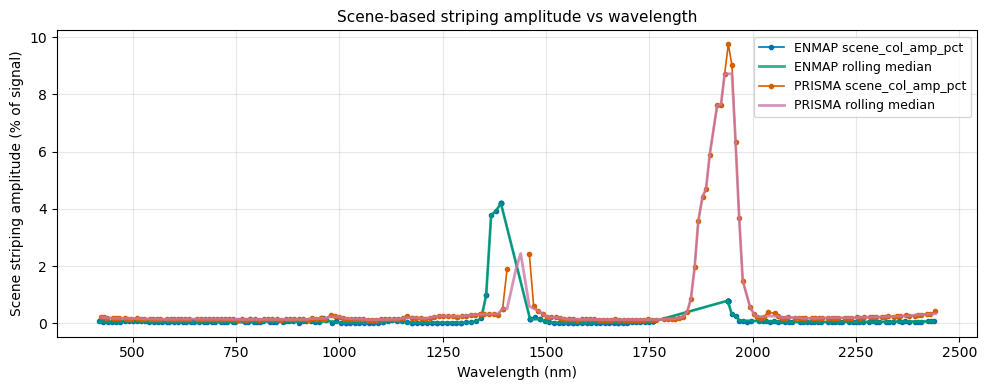

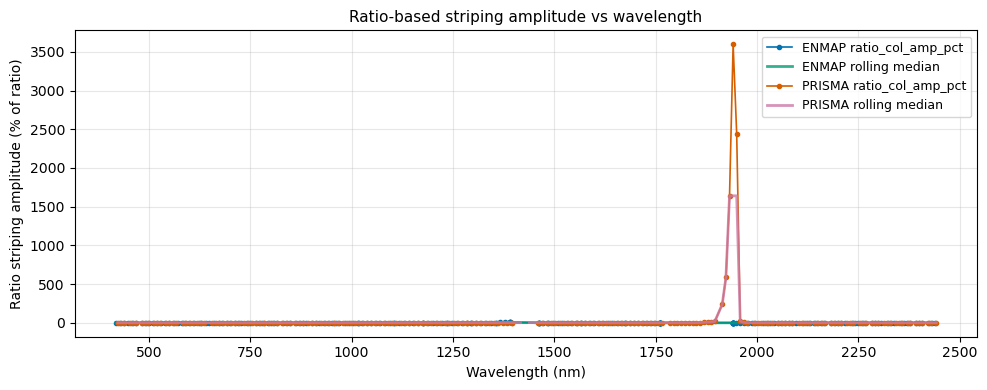

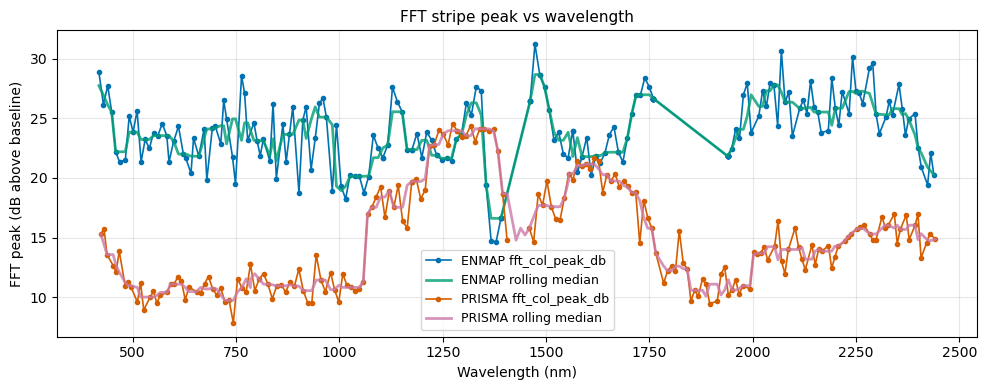

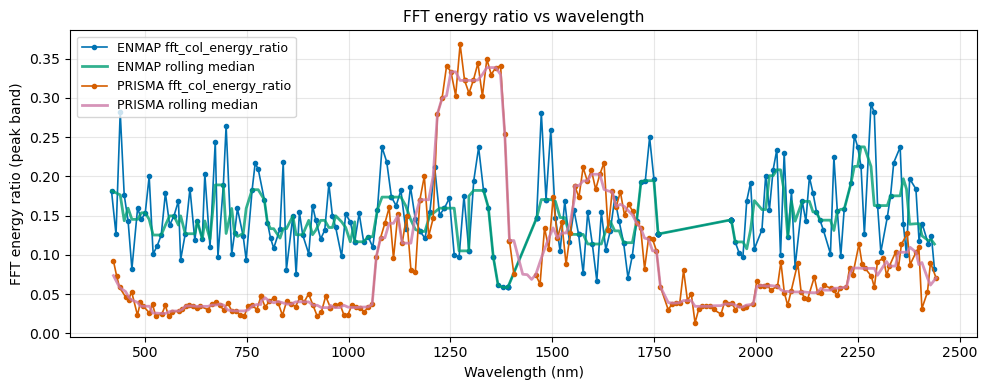

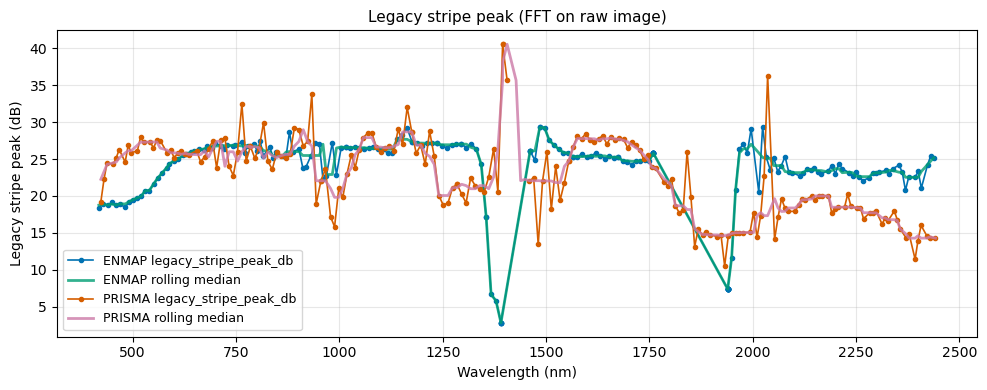

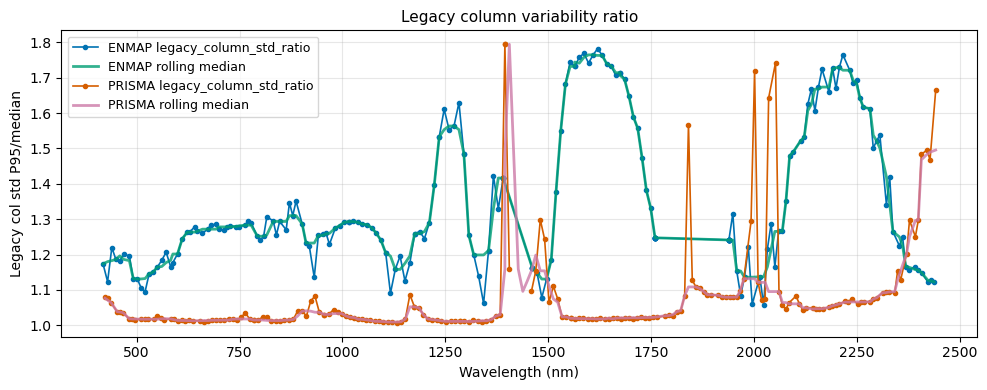

In [15]:
def plot_metric(df: pd.DataFrame, column: str, ylabel: str, title: str, rolling: int = 5, filename: str | None = None, paper_name: str | None = None):
    fig, ax = plt.subplots(1, 1, figsize=(10, 4))
    for sensor, sub in df.groupby("sensor"):
        sub = sub.sort_values("band_nm")
        ax.plot(sub["band_nm"], sub[column], marker="o", ms=3, lw=1.2, label=f"{sensor} {column}")
        roll = sub[column].rolling(window=rolling, min_periods=1, center=True).median()
        ax.plot(sub["band_nm"], roll, lw=2.0, alpha=0.8, label=f"{sensor} rolling median")
    ax.set_xlabel("Wavelength (nm)")
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    ax.grid(alpha=0.3)
    ax.legend()
    fig.tight_layout()
    if SAVE_FIGURES and filename:
        FIG_DIR.mkdir(parents=True, exist_ok=True)
        fig.savefig(FIG_DIR / filename, dpi=200)
    if SAVE_FIGURES and paper_name:
        PAPER_FIG_DIR.mkdir(parents=True, exist_ok=True)
        fig.savefig(PAPER_FIG_DIR / f"{paper_name}.png", dpi=300, bbox_inches="tight")
        fig.savefig(PAPER_FIG_DIR / f"{paper_name}.pdf", dpi=300, bbox_inches="tight")
    plt.show()

# Scene-based amplitude
plot_metric(
    striping_df,
    "scene_col_amp_pct",
    "Scene striping amplitude (% of signal)",
    "Scene-based striping amplitude vs wavelength",
    filename="fig_scene_amp_vs_wavelength.png",
    paper_name="FIG_scene_amp_vs_wavelength",
)

# Ratio-based amplitude
plot_metric(
    striping_df,
    "ratio_col_amp_pct",
    "Ratio striping amplitude (% of ratio)",
    "Ratio-based striping amplitude vs wavelength",
    filename="fig_ratio_amp_vs_wavelength.png",
    paper_name="FIG_ratio_amp_vs_wavelength",
)

# FFT periodicity
plot_metric(
    striping_df,
    "fft_col_peak_db",
    "FFT peak (dB above baseline)",
    "FFT stripe peak vs wavelength",
    filename="fig_fft_peak_vs_wavelength.png",
    paper_name="FIG_fft_peak_vs_wavelength",
)
plot_metric(
    striping_df,
    "fft_col_energy_ratio",
    "FFT energy ratio (peak band)",
    "FFT energy ratio vs wavelength",
    filename="fig_fft_energy_vs_wavelength.png",
    paper_name="FIG_fft_energy_vs_wavelength",
)

# Legacy quick-look (optional)
plot_metric(
    striping_df,
    "legacy_stripe_peak_db",
    "Legacy stripe peak (dB)",
    "Legacy stripe peak (FFT on raw image)",
)
plot_metric(
    striping_df,
    "legacy_column_std_ratio",
    "Legacy col std P95/median",
    "Legacy column variability ratio",
)


## Defective column runs diagnostic
Robust z-score of per-column residual MAD to detect contiguous noisy/miscalibrated column groups.

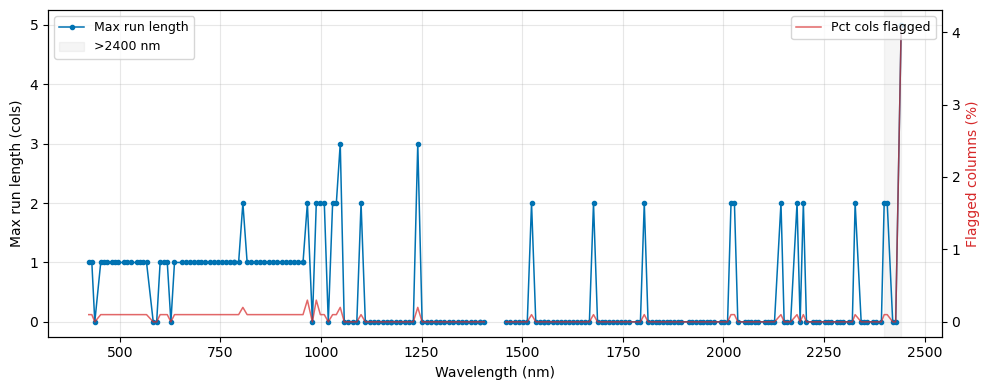

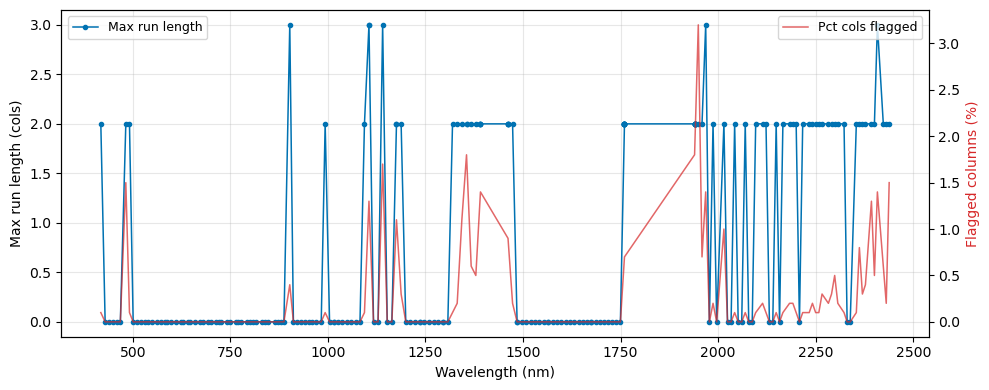

In [16]:
def plot_defective_columns(df: pd.DataFrame, sensor: str = "PRISMA", thresh_label: str = "z6", paper_name: str | None = None):
    sub = df[df["sensor"] == sensor]
    fig, ax1 = plt.subplots(1, 1, figsize=(10, 4))
    ax1.plot(sub["band_nm"], sub[f"col_outlier_max_run_{thresh_label}"], marker="o", ms=3, lw=1.1, label="Max run length")
    ax1.set_xlabel("Wavelength (nm)")
    ax1.set_ylabel("Max run length (cols)")
    ax1.grid(alpha=0.3)
    ax2 = ax1.twinx()
    ax2.plot(sub["band_nm"], sub[f"col_outlier_pct_{thresh_label}"], color="tab:red", alpha=0.7, lw=1.1, label="Pct cols flagged")
    ax2.set_ylabel("Flagged columns (%)", color="tab:red")
    if sensor.upper() == "PRISMA":
        ax1.axvspan(2400, sub["band_nm"].max(), color="gray", alpha=0.08, label=">2400 nm")
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")
    fig.tight_layout()
    if SAVE_FIGURES and paper_name:
        PAPER_FIG_DIR.mkdir(parents=True, exist_ok=True)
        fig.savefig(PAPER_FIG_DIR / f"{paper_name}.png", dpi=300, bbox_inches="tight")
        fig.savefig(PAPER_FIG_DIR / f"{paper_name}.pdf", dpi=300, bbox_inches="tight")
    plt.show()

plot_defective_columns(striping_df, sensor="PRISMA", thresh_label="z6", paper_name="FIG_S1_prisma_defective_columns")
plot_defective_columns(striping_df, sensor="ENMAP", thresh_label="z6", paper_name=None)


## Methane absorption windows
Zoom the same metrics into CH4 windows (~1650, ~2300 nm).

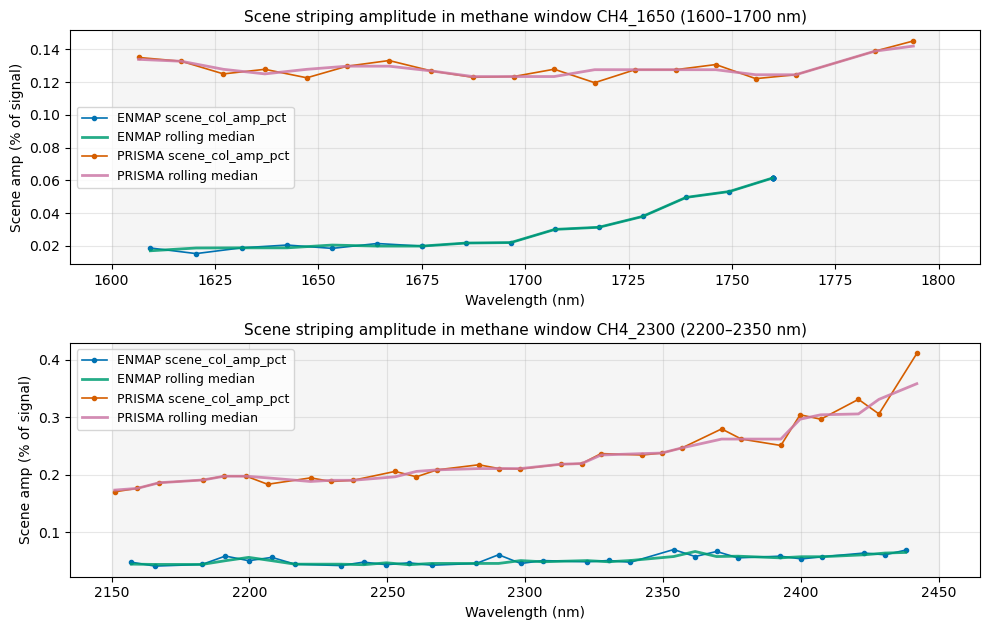

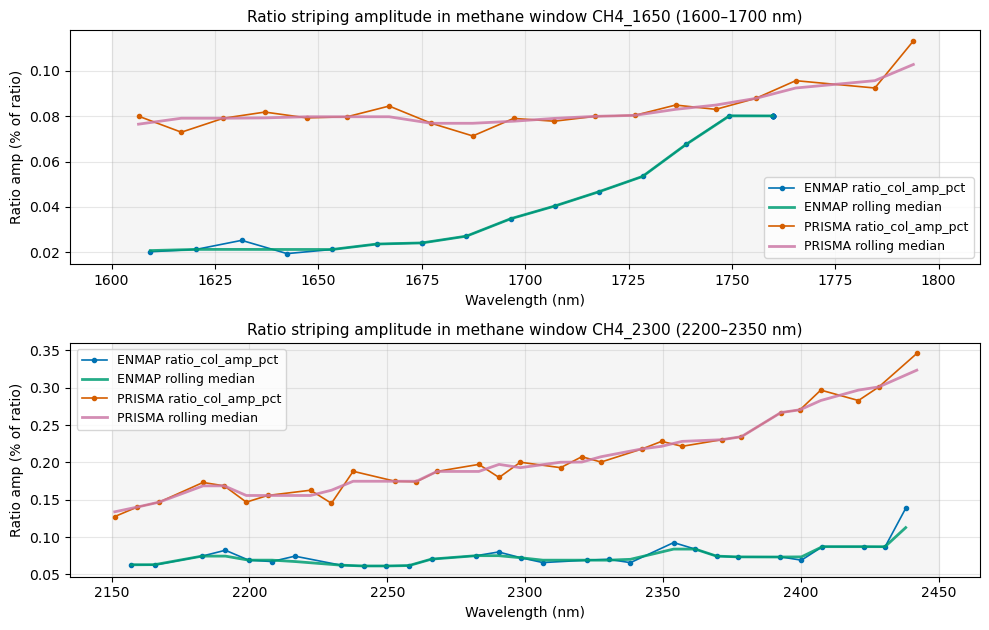

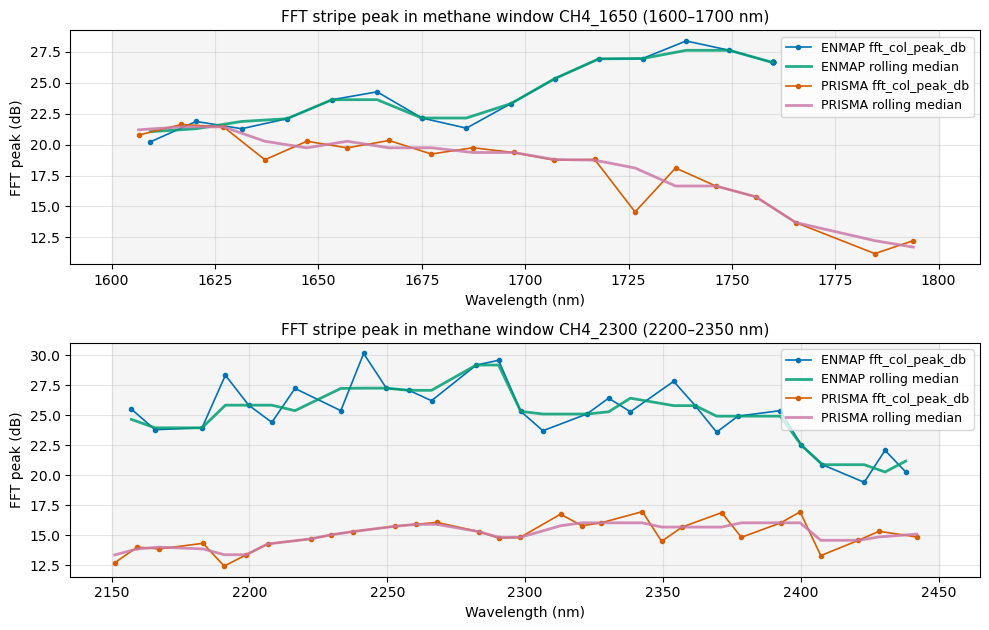

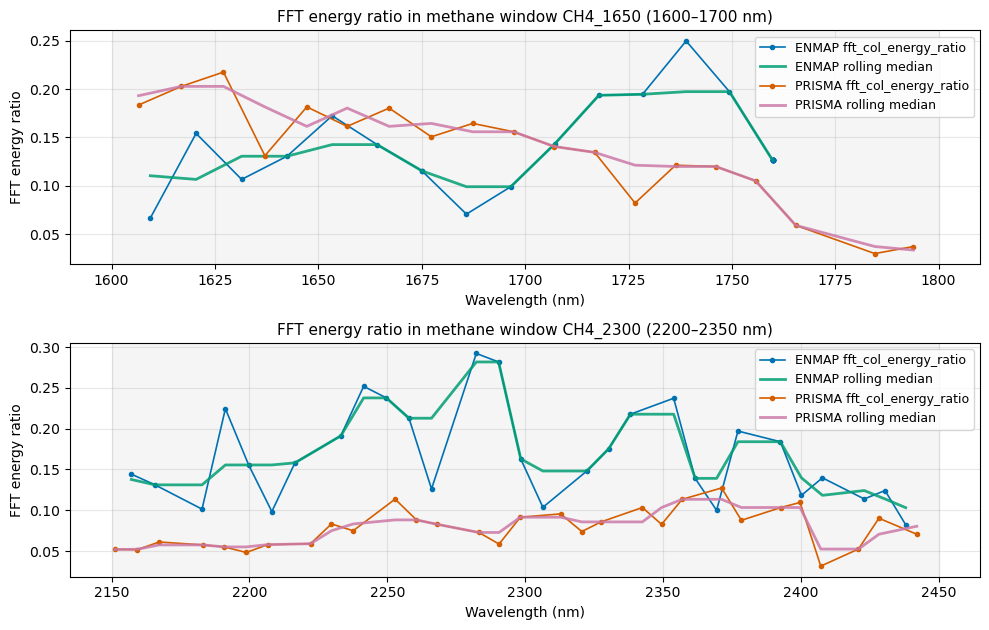

In [17]:
def plot_windows(df: pd.DataFrame, windows: dict, metric: str, ylabel: str, title_prefix: str, rolling: int = 3, filename_prefix: str | None = None, paper_prefix: str | None = None):
    fig, axes = plt.subplots(len(windows), 1, figsize=(10, 3.2 * len(windows)), sharex=False)
    if len(windows) == 1:
        axes = [axes]
    for ax, (label, (lo, hi)) in zip(axes, windows.items()):
        sub = df[(df["band_nm"] >= lo) & (df["band_nm"] <= hi)]
        for sensor, grp in sub.groupby("sensor"):
            grp = grp.sort_values("band_nm")
            ax.plot(grp["band_nm"], grp[metric], marker="o", ms=3, lw=1.2, label=f"{sensor} {metric}")
            roll = grp[metric].rolling(window=rolling, min_periods=1, center=True).median()
            ax.plot(grp["band_nm"], roll, lw=2.0, alpha=0.85, label=f"{sensor} rolling median")
        ax.axvspan(lo, hi, color="gray", alpha=0.08)
        ax.set_title(f"{title_prefix} {label}")
        ax.set_xlabel("Wavelength (nm)")
        ax.set_ylabel(ylabel)
        ax.grid(alpha=0.3)
        ax.legend()
    fig.tight_layout()
    if SAVE_FIGURES and filename_prefix:
        FIG_DIR.mkdir(parents=True, exist_ok=True)
        fig.savefig(FIG_DIR / f"{filename_prefix}_{metric}.png", dpi=200)
    if SAVE_FIGURES and paper_prefix:
        PAPER_FIG_DIR.mkdir(parents=True, exist_ok=True)
        fig.savefig(PAPER_FIG_DIR / f"{paper_prefix}_{metric}.png", dpi=300, bbox_inches="tight")
        fig.savefig(PAPER_FIG_DIR / f"{paper_prefix}_{metric}.pdf", dpi=300, bbox_inches="tight")
    plt.show()

plot_windows(striping_df, CH4_WINDOWS, "scene_col_amp_pct", "Scene amp (% of signal)", "Scene striping amplitude in methane window", filename_prefix="fig_window_scene_amp", paper_prefix="FIG_window_scene_amp")
plot_windows(striping_df, CH4_WINDOWS, "ratio_col_amp_pct", "Ratio amp (% of ratio)", "Ratio striping amplitude in methane window", filename_prefix="fig_window_ratio_amp", paper_prefix="FIG_window_ratio_amp")
plot_windows(striping_df, CH4_WINDOWS, "fft_col_peak_db", "FFT peak (dB)", "FFT stripe peak in methane window", filename_prefix="fig_window_fft_peak", paper_prefix="FIG_window_fft_peak")
plot_windows(striping_df, CH4_WINDOWS, "fft_col_energy_ratio", "FFT energy ratio", "FFT energy ratio in methane window", filename_prefix="fig_window_fft_energy", paper_prefix="FIG_window_fft_energy")


## FFT period summary
Peak frequency (cycles/pixel) and period (pixels) within methane windows.

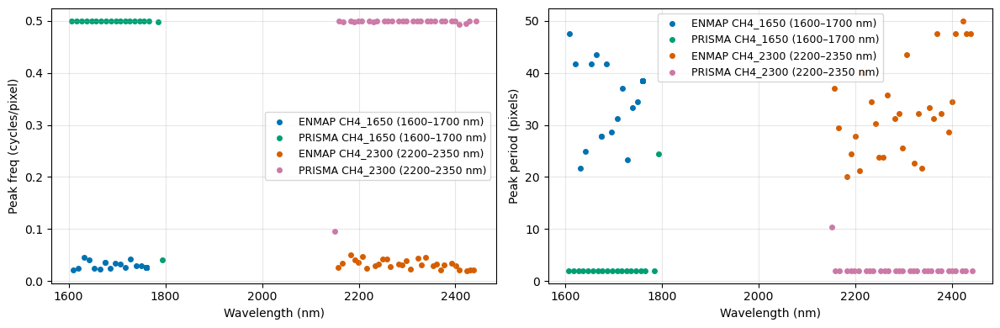

In [18]:
def plot_fft_period(df: pd.DataFrame, windows: dict, paper_name: str = "FIG_3_fft_period_summary"):
    fig, axes = plt.subplots(1, 2, figsize=(12, 4), sharex=False)
    for (label, (lo, hi)) in windows.items():
        sub = df[(df["band_nm"] >= lo) & (df["band_nm"] <= hi)]
        for sensor, grp in sub.groupby("sensor"):
            grp = grp.sort_values("band_nm")
            axes[0].scatter(grp["band_nm"], grp["fft_col_peak_freq_cyc_per_px"], s=16, label=f"{sensor} {label}")
            period = 1.0 / np.clip(grp["fft_col_peak_freq_cyc_per_px"], EPS, None)
            axes[1].scatter(grp["band_nm"], period, s=16, label=f"{sensor} {label}")
    axes[0].set_xlabel("Wavelength (nm)")
    axes[0].set_ylabel("Peak freq (cycles/pixel)")
    axes[0].grid(alpha=0.3)
    axes[0].legend()
    axes[1].set_xlabel("Wavelength (nm)")
    axes[1].set_ylabel("Peak period (pixels)")
    axes[1].grid(alpha=0.3)
    axes[1].legend()
    fig.tight_layout()
    if SAVE_FIGURES:
        PAPER_FIG_DIR.mkdir(parents=True, exist_ok=True)
        fig.savefig(PAPER_FIG_DIR / f"{paper_name}.png", dpi=300, bbox_inches="tight")
        fig.savefig(PAPER_FIG_DIR / f"{paper_name}.pdf", dpi=300, bbox_inches="tight")
    plt.show()

plot_fft_period(striping_df, CH4_WINDOWS)


## Worst-band column snapshots
Inspect the top bands by scene, ratio, and FFT metrics: raw and residual images, column-offset vector, and FFT power.

ENMAP: worst 2 by scene_col_amp_pct (scene amplitude)


,band_nm,scene_col_amp_pct,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
98,1390.84,4.18907,16.613231,4.18907,5.344303
100,1390.84,4.18907,16.613231,4.18907,5.344303


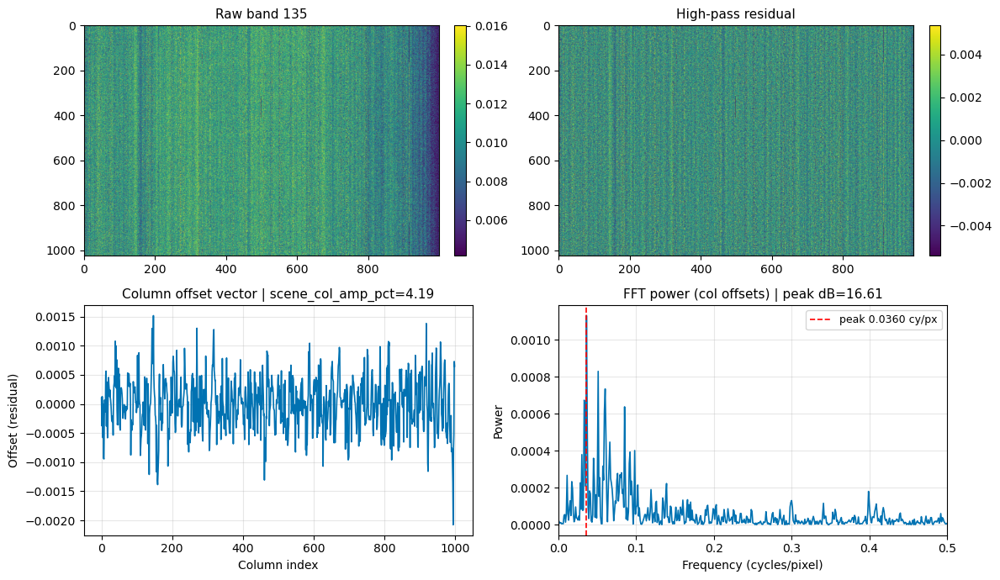

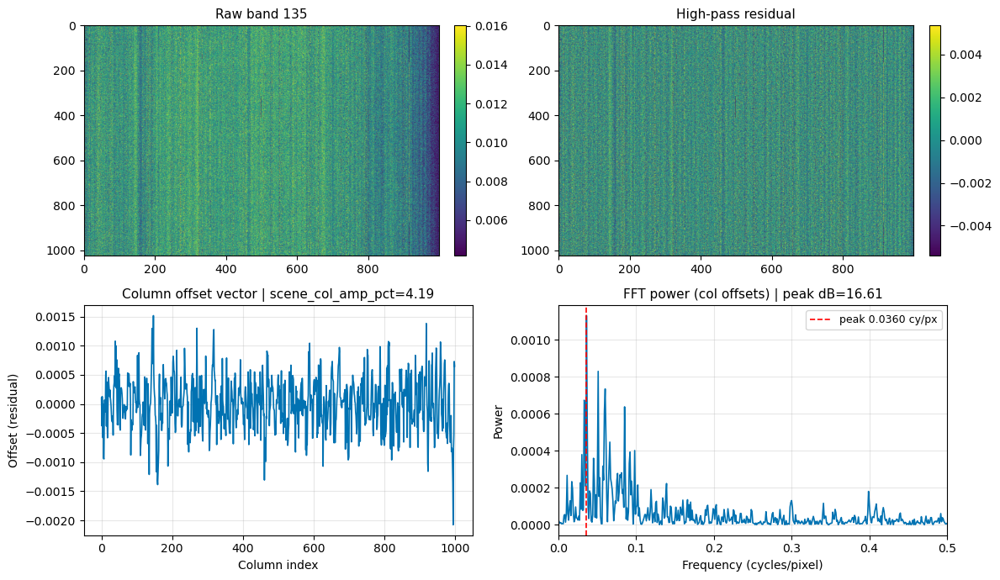

PRISMA: worst 2 by scene_col_amp_pct (scene amplitude)


,band_nm,scene_col_amp_pct,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
355,1940.924820,9.749114,10.191522,9.749114,3597.536190
356,1949.715384,9.012618,10.601499,9.012618,2440.889985


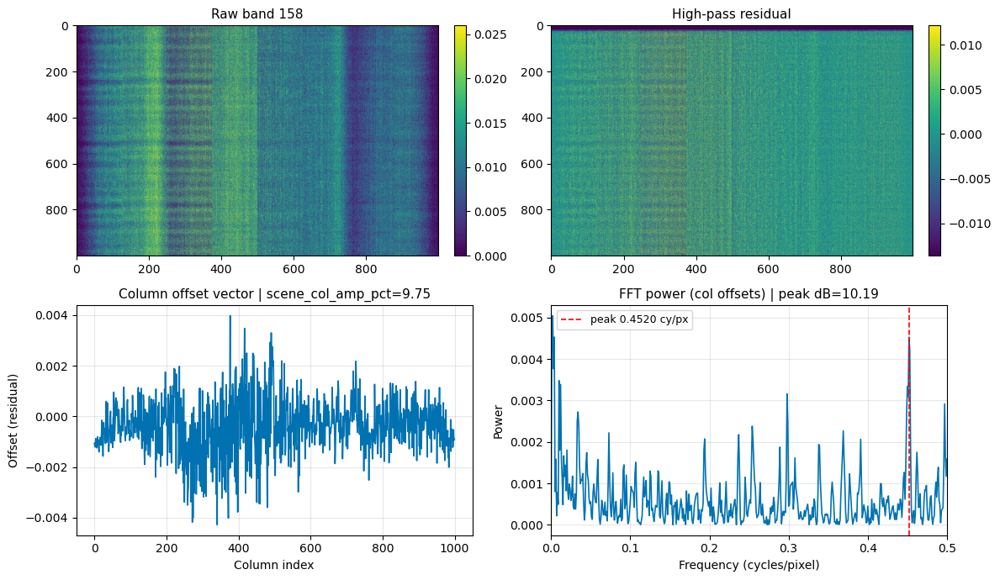

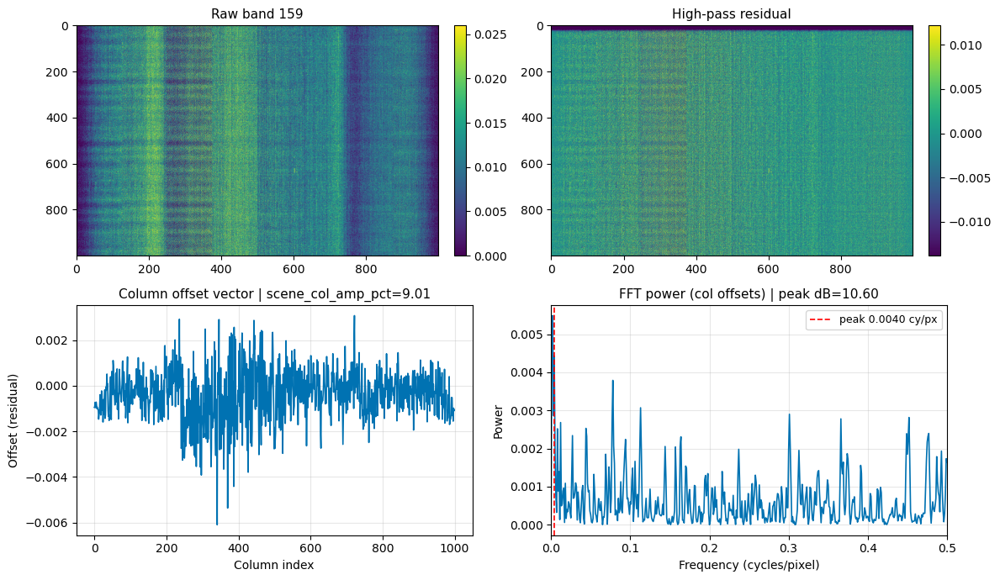

ENMAP: worst 2 by ratio_col_amp_pct (ratio amplitude)


,band_nm,ratio_col_amp_pct,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
98,1390.84,5.344303,16.613231,4.18907,5.344303
100,1390.84,5.344303,16.613231,4.18907,5.344303


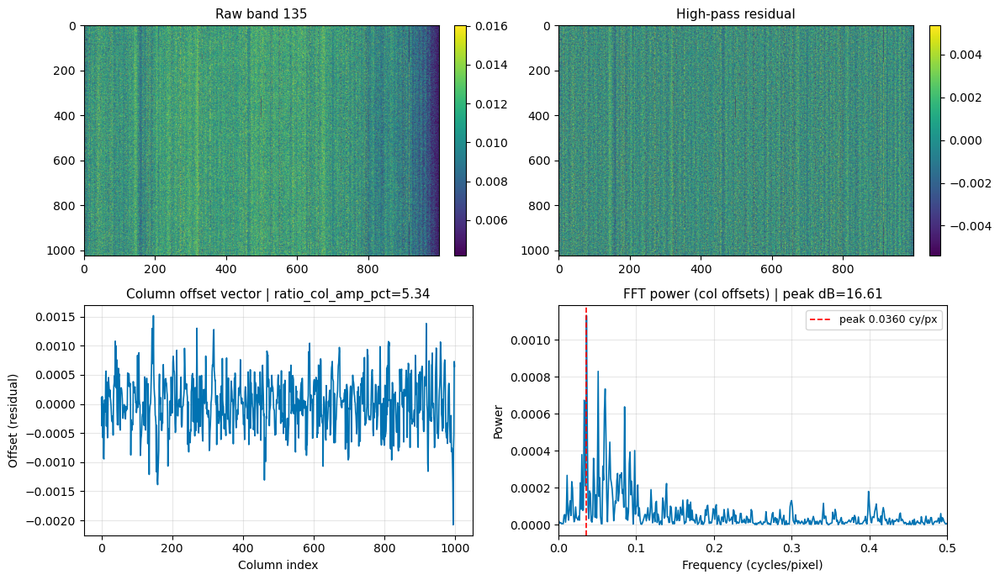

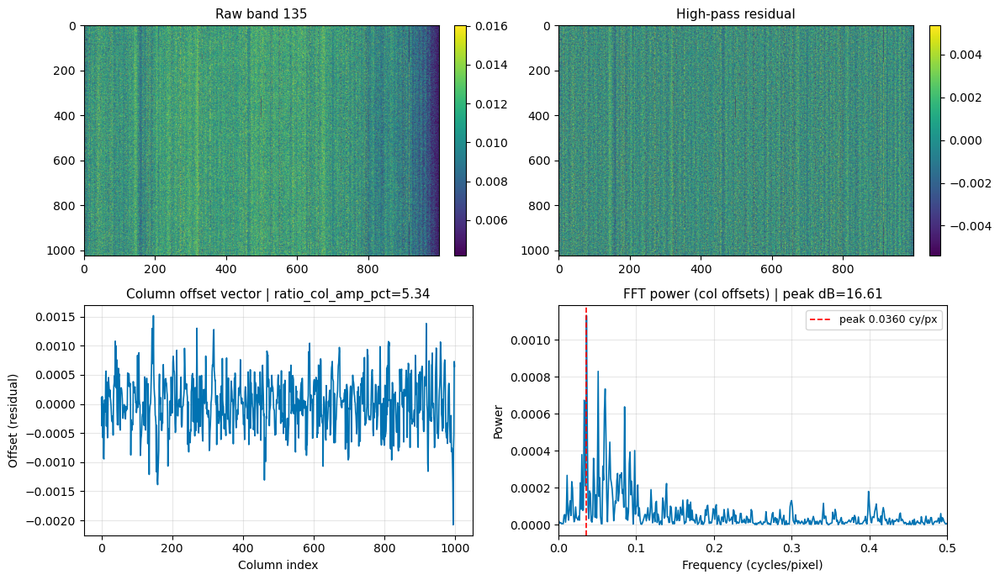

PRISMA: worst 2 by ratio_col_amp_pct (ratio amplitude)


,band_nm,ratio_col_amp_pct,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
355,1940.924820,3597.536190,10.191522,9.749114,3597.536190
356,1949.715384,2440.889985,10.601499,9.012618,2440.889985


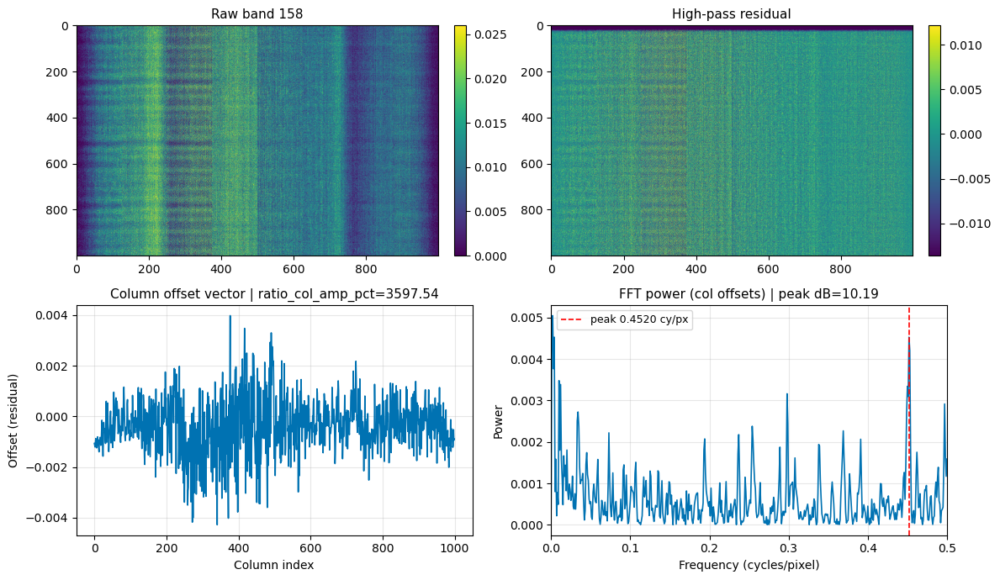

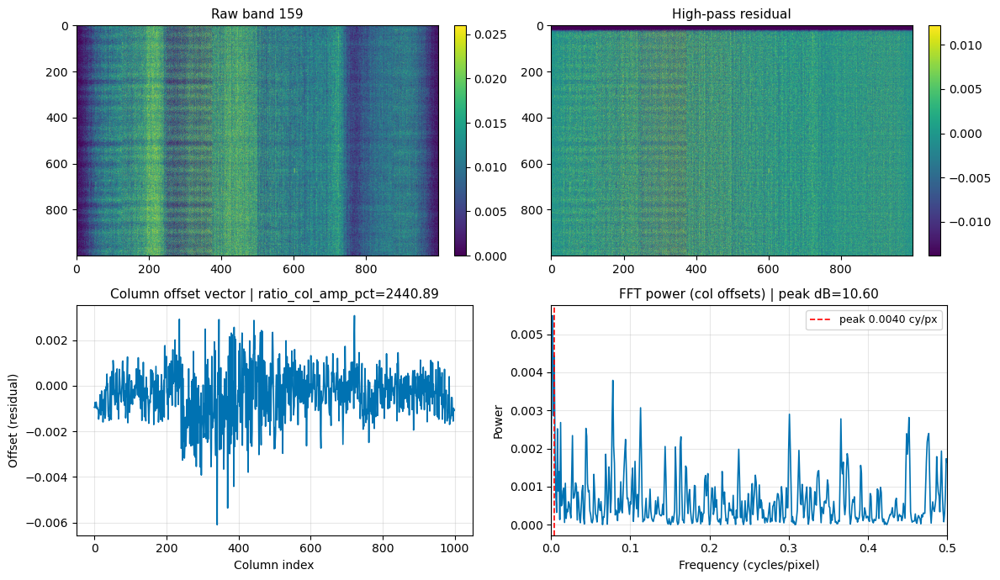

ENMAP: worst 2 by fft_col_energy_ratio (FFT energy)


,band_nm,fft_col_energy_ratio,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
186,2282.290,0.292113,29.191145,0.046264,0.075154
2,439.504,0.281812,27.734953,0.050576,0.071136


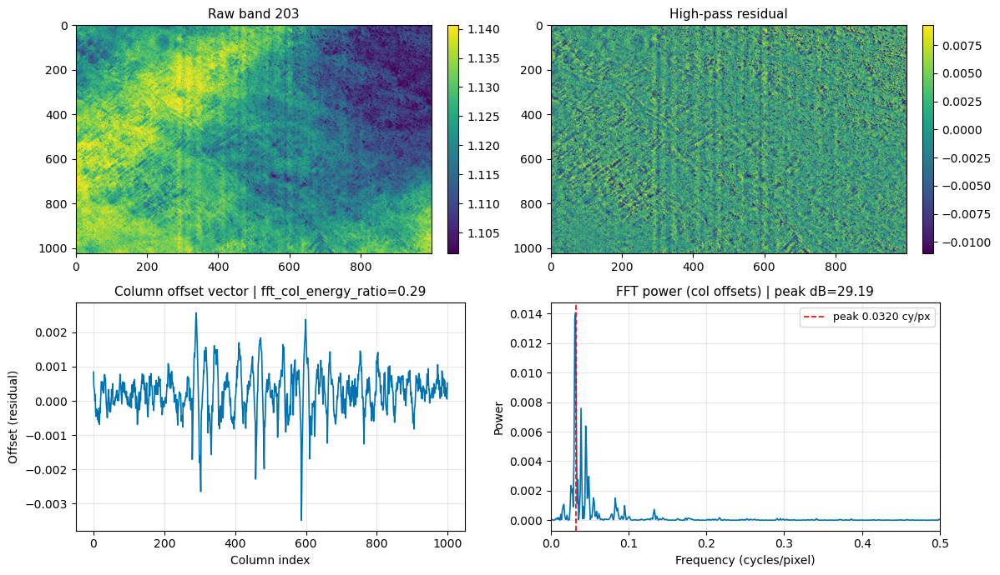

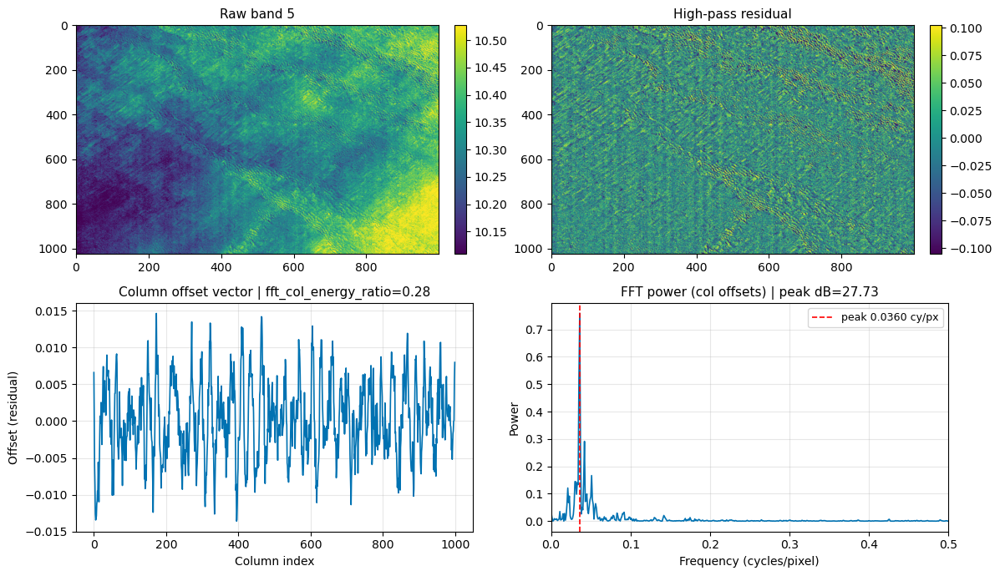

PRISMA: worst 2 by fft_col_energy_ratio (FFT energy)


,band_nm,fft_col_energy_ratio,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
288,1273.812266,0.368422,24.543218,0.241163,0.110356
295,1339.399745,0.349564,24.117381,0.312784,0.198978


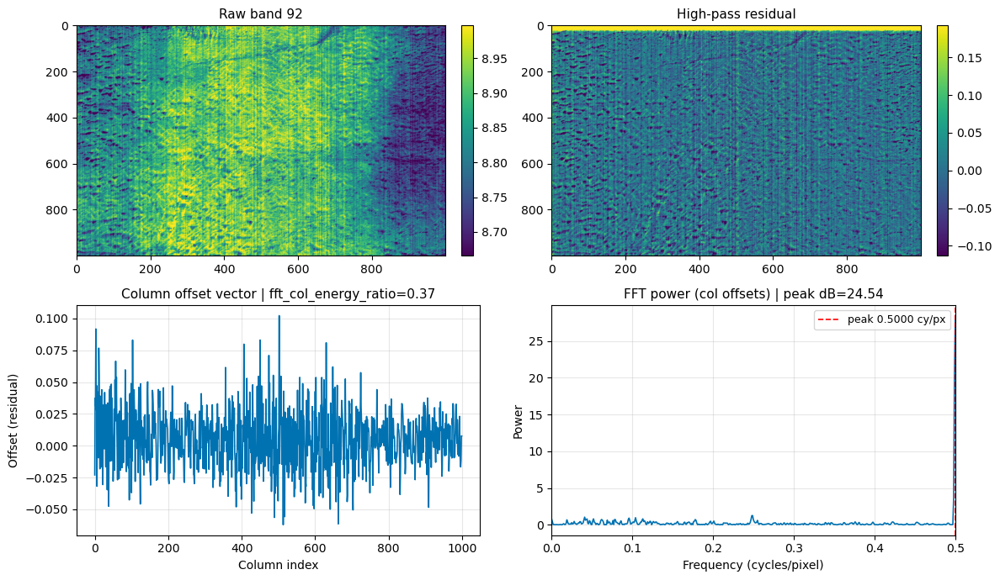

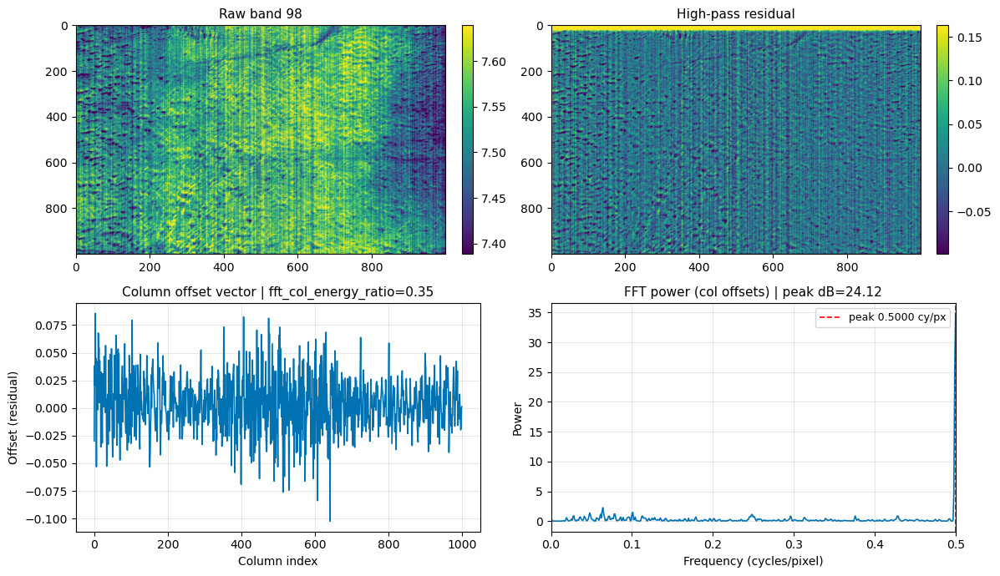

In [19]:
from IPython.display import display

def plot_band_diagnostics(img: np.ndarray, title: str, cmap: str = "viridis"):
    vmin, vmax = np.nanpercentile(img, [2, 98]) if np.isfinite(img).any() else (0, 1)
    plt.imshow(img, cmap=cmap, vmin=vmin, vmax=vmax)
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.title(title)
    plt.axis('tight')

def inspect_band(scene: Dict[str, Any], band_idx: int, roi_spec: Optional[str], metric_label: str):
    img = scene["cube_brc"][band_idx].astype(float)
    img = apply_roi_and_crop(img, roi_spec, EDGE_CROP_COLS)
    resid = highpass(img)
    m_col = np.nanmedian(resid, axis=0)
    fft_col = fft_periodic_metrics(m_col, min_freq=MIN_FREQ_CYC_PER_PX, half_width_bins=PEAK_HALF_WIDTH_BINS)
    freqs = np.fft.rfftfreq(m_col.size, d=1.0)
    window = np.hanning(m_col.size)
    power = np.abs(np.fft.rfft((m_col - np.nanmedian(m_col)) * window)) ** 2

    fig, axes = plt.subplots(2, 2, figsize=(12, 7))
    plt.sca(axes[0, 0])
    plot_band_diagnostics(img, f"Raw band {band_idx+1}")
    plt.sca(axes[0, 1])
    plot_band_diagnostics(resid, f"High-pass residual")
    axes[1, 0].plot(m_col, lw=1.2)
    axes[1, 0].set_title(f"Column offset vector | {metric_label}")
    axes[1, 0].set_xlabel("Column index")
    axes[1, 0].set_ylabel("Offset (residual)")
    axes[1, 0].grid(alpha=0.3)
    axes[1, 1].plot(freqs, power, lw=1.2)
    peak_freq = fft_col.get("peak_freq")
    if peak_freq is not None and np.isfinite(peak_freq):
        axes[1, 1].axvline(peak_freq, color="r", lw=1.2, ls="--", label=f"peak {peak_freq:.4f} cy/px")
    axes[1, 1].set_xlim(0, freqs.max() if freqs.size else 1)
    axes[1, 1].set_title(f"FFT power (col offsets) | peak dB={fft_col.get('peak_db'):.2f}")
    axes[1, 1].set_xlabel("Frequency (cycles/pixel)")
    axes[1, 1].set_ylabel("Power")
    axes[1, 1].grid(alpha=0.3)
    axes[1, 1].legend()
    fig.tight_layout()
    plt.show()


def plot_worst_band(striping_df: pd.DataFrame, scenes: Dict[str, Dict[str, Any]], metric: str, n: int = 2, desc: str = ""):
    for sensor, sub in striping_df.groupby("sensor"):
        worst = sub.sort_values(metric, ascending=False).head(n)
        roi_spec = SCENE_CONFIG[sensor.lower()].get("striping_roi")
        print(f"{sensor}: worst {len(worst)} by {metric} {desc}")
        display(worst[["band_nm", metric, "fft_col_peak_db", "scene_col_amp_pct", "ratio_col_amp_pct"]])
        scene = scenes[sensor.lower()]
        for _, row in worst.iterrows():
            inspect_band(scene, int(row["band_index"]) - 1, roi_spec, metric_label=f"{metric}={row[metric]:.2f}")

plot_worst_band(striping_df, {"prisma": prisma_scene, "enmap": enmap_scene}, metric="scene_col_amp_pct", n=2, desc="(scene amplitude)")
plot_worst_band(striping_df, {"prisma": prisma_scene, "enmap": enmap_scene}, metric="ratio_col_amp_pct", n=2, desc="(ratio amplitude)")
plot_worst_band(striping_df, {"prisma": prisma_scene, "enmap": enmap_scene}, metric="fft_col_energy_ratio", n=2, desc="(FFT energy)")


## Worst 5 bands within methane windows
Top striping bands inside CH4 windows, using scene-based amplitude; plots reuse the diagnostic visuals.

CH4_1650 (1600–1700 nm): 1600-1800 nm
  ENMAP: worst 5 bands by scene_col_amp_pct


,band_nm,scene_col_amp_pct,fft_col_peak_db,fft_col_energy_ratio,ratio_col_amp_pct
135,1759.83,0.061405,26.648198,0.126572,0.080111
136,1759.83,0.061405,26.648198,0.126572,0.080111
137,1759.83,0.061405,26.648198,0.126572,0.080111
138,1759.83,0.061405,26.648198,0.126572,0.080111
139,1759.83,0.061405,26.648198,0.126572,0.080111


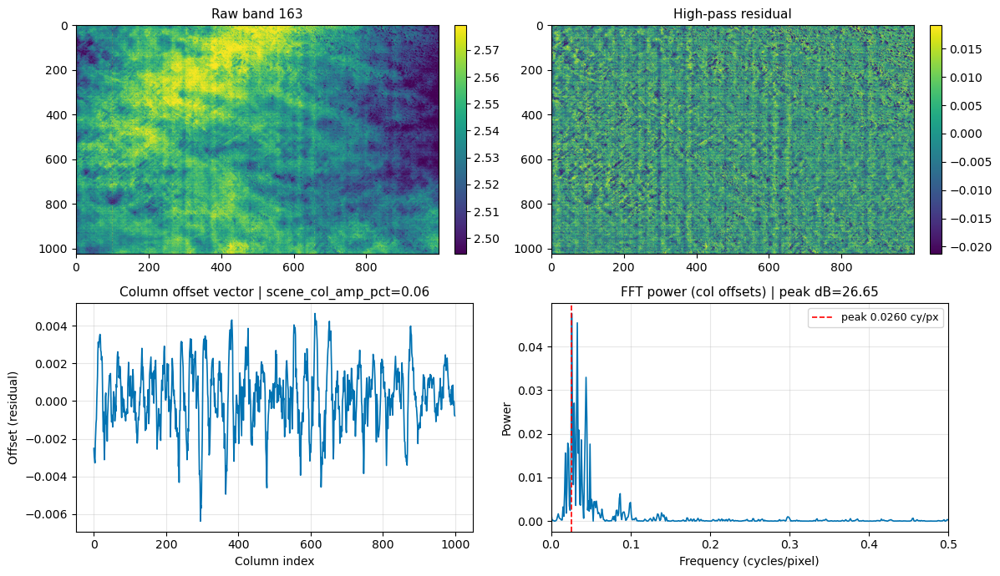

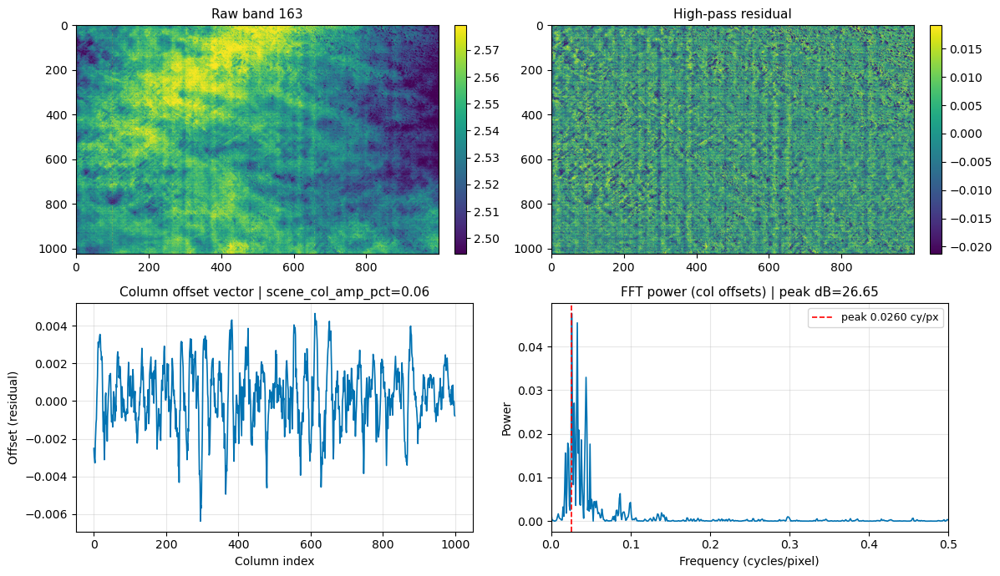

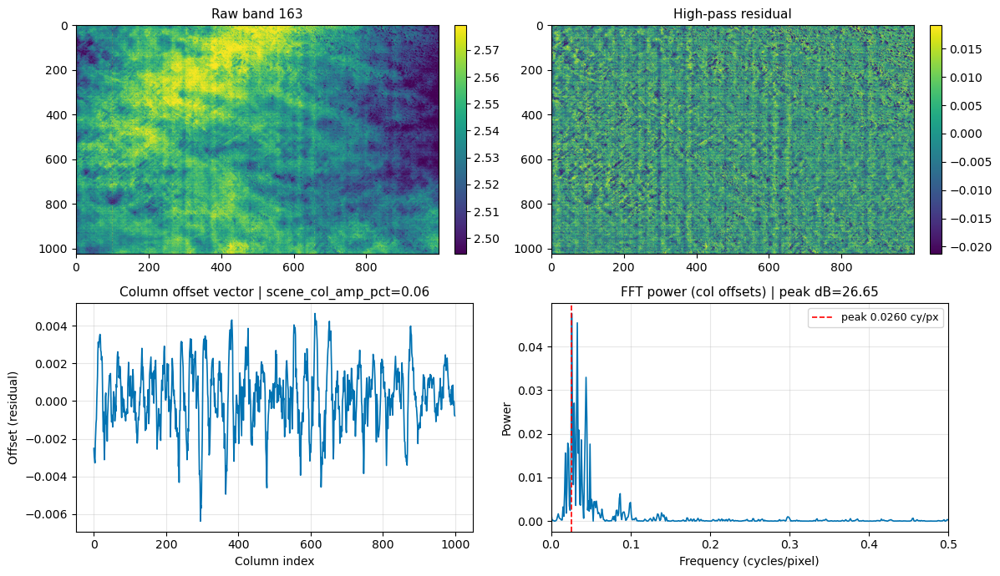

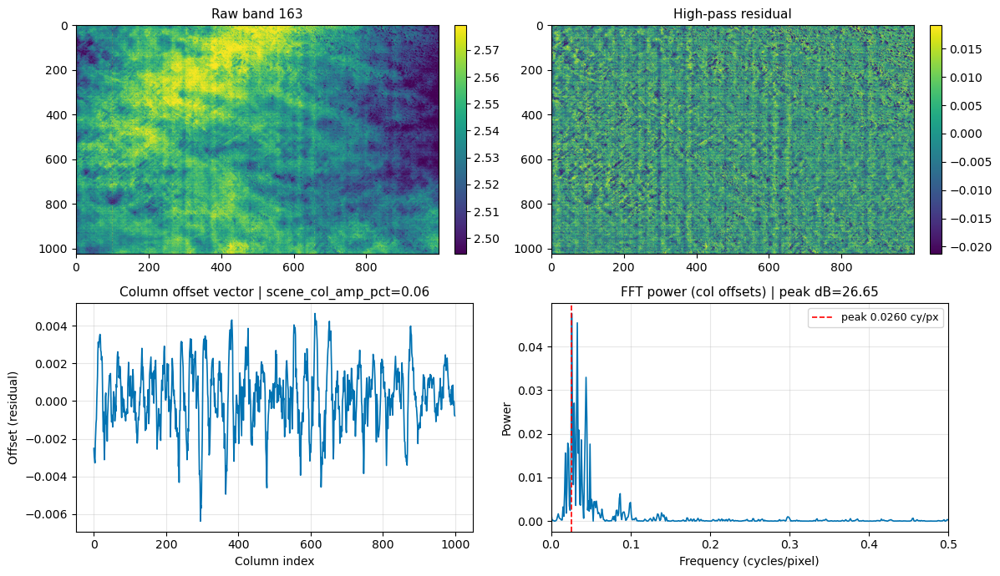

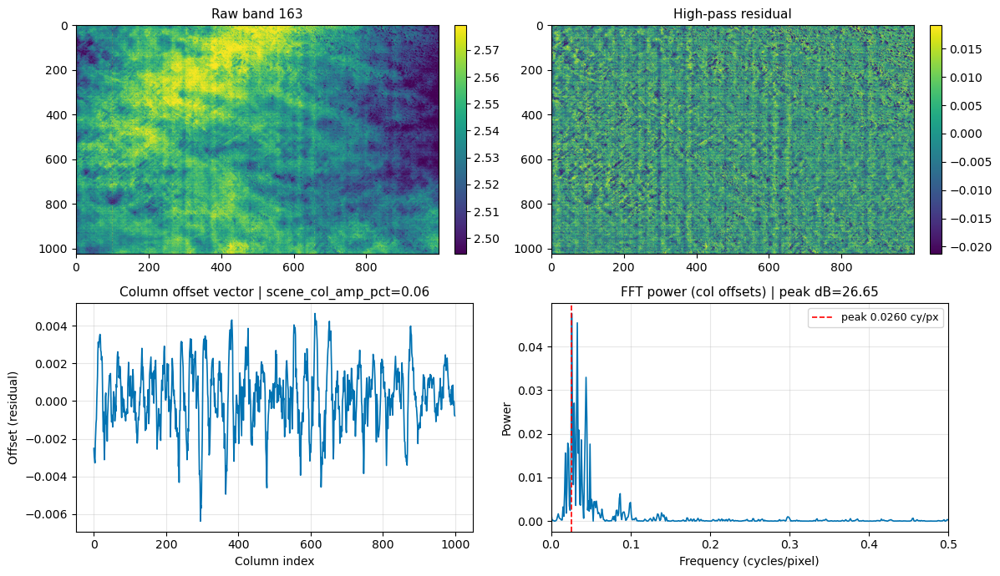

  PRISMA: worst 5 bands by scene_col_amp_pct


,band_nm,scene_col_amp_pct,fft_col_peak_db,fft_col_energy_ratio,ratio_col_amp_pct
340,1793.882201,0.145127,12.225825,0.037415,0.113112
339,1784.570301,0.138893,11.180178,0.030118,0.092391
322,1606.499244,0.135063,20.766999,0.183458,0.079985
328,1667.109568,0.133175,20.334639,0.180292,0.084439
323,1616.861924,0.132730,21.629961,0.202730,0.072926


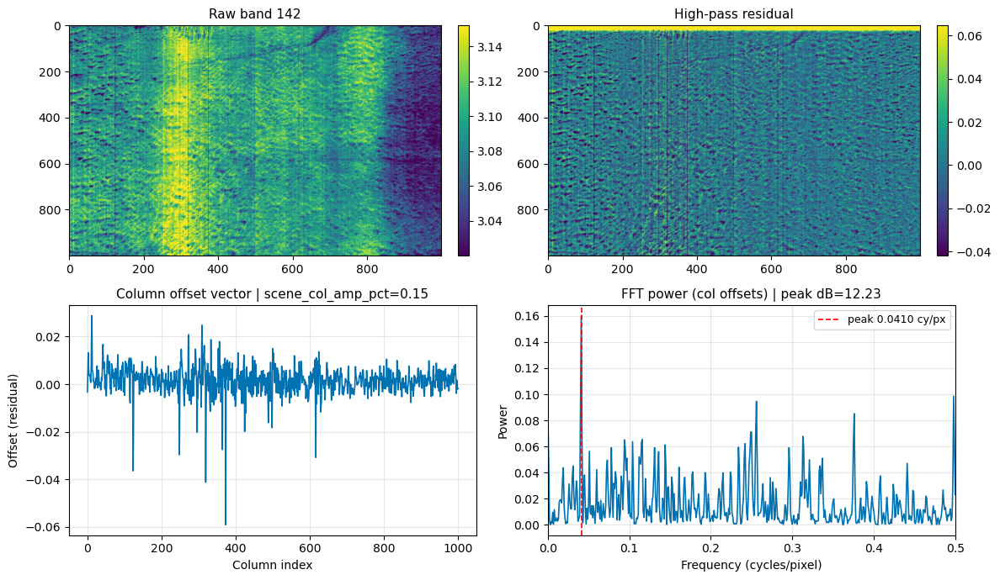

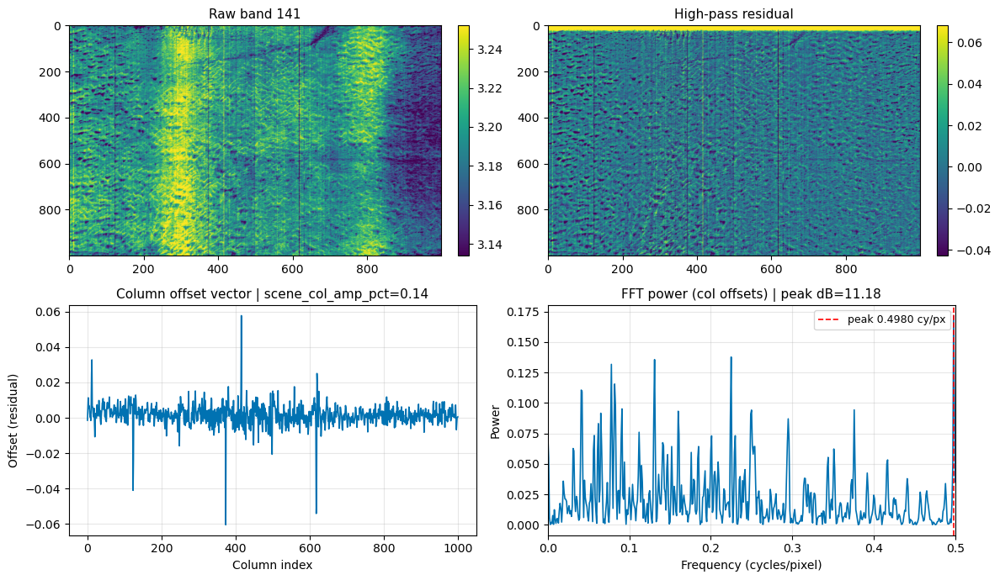

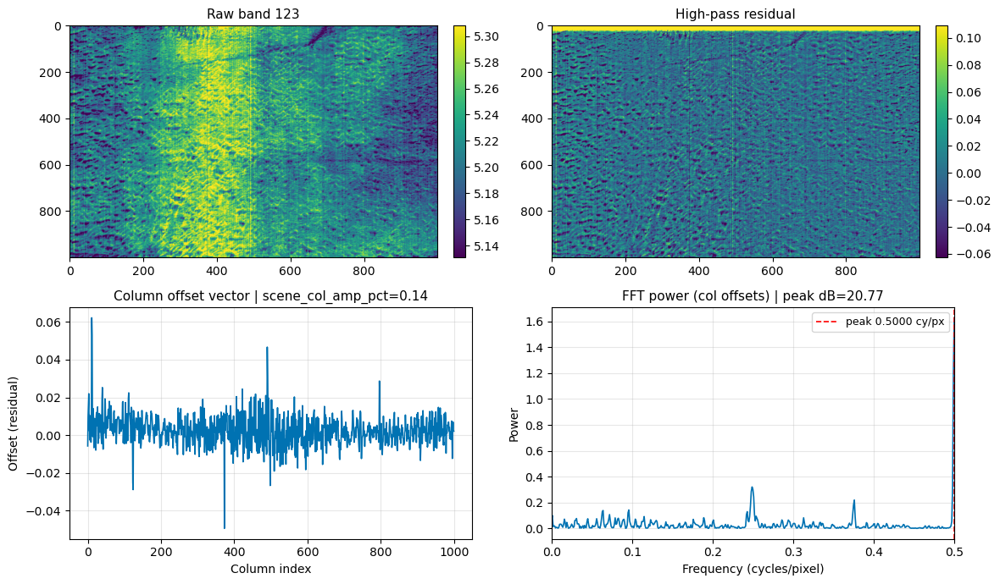

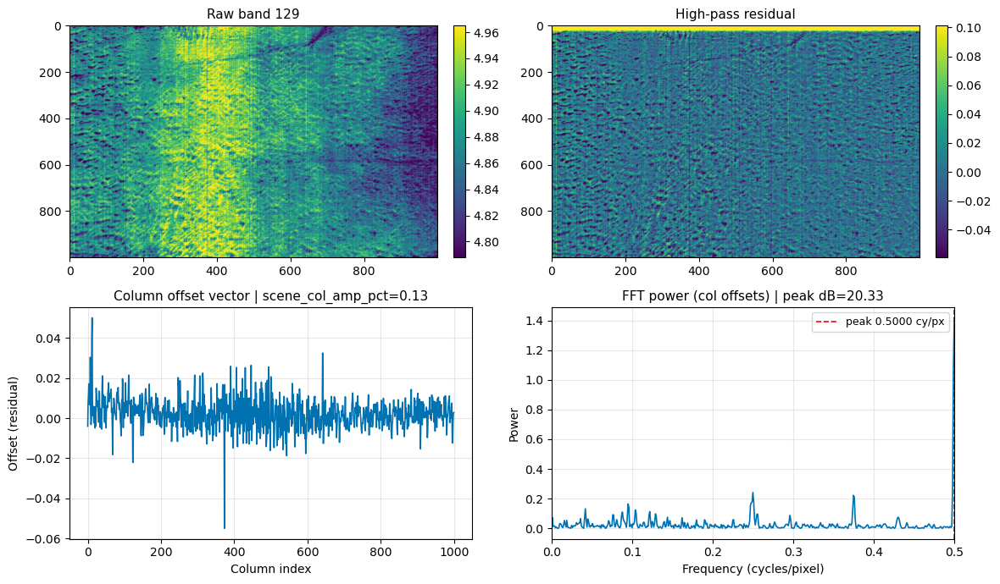

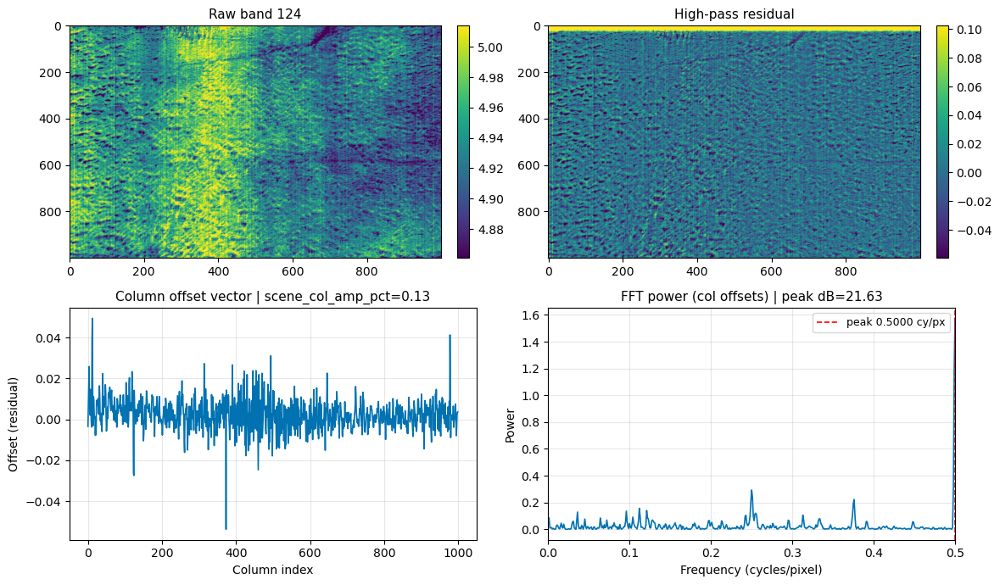

CH4_2300 (2200–2350 nm): 2150-2450 nm
  ENMAP: worst 5 bands by scene_col_amp_pct


,band_nm,scene_col_amp_pct,fft_col_peak_db,fft_col_energy_ratio,ratio_col_amp_pct
193,2353.88,0.070384,27.834223,0.237222,0.092689
202,2438.05,0.069418,20.278254,0.082185,0.138606
195,2369.45,0.067007,23.594209,0.099904,0.074543
200,2423.01,0.064308,19.413339,0.113833,0.087235
187,2290.37,0.061348,29.587326,0.281704,0.080105


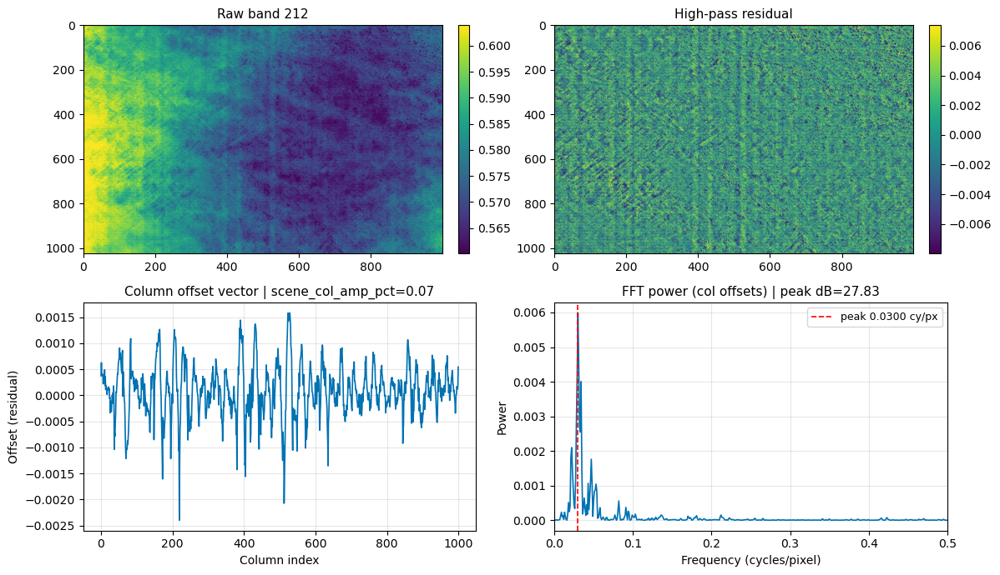

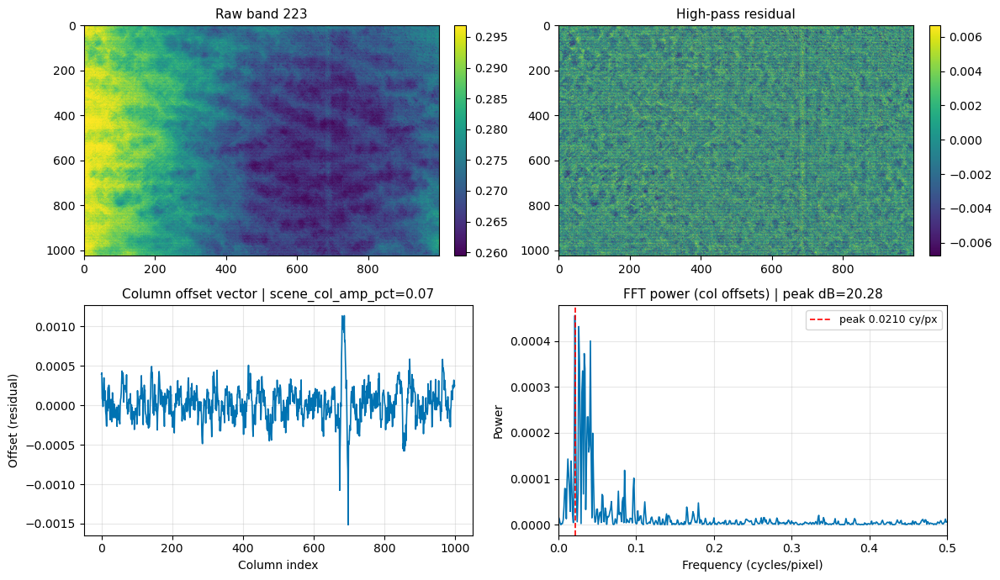

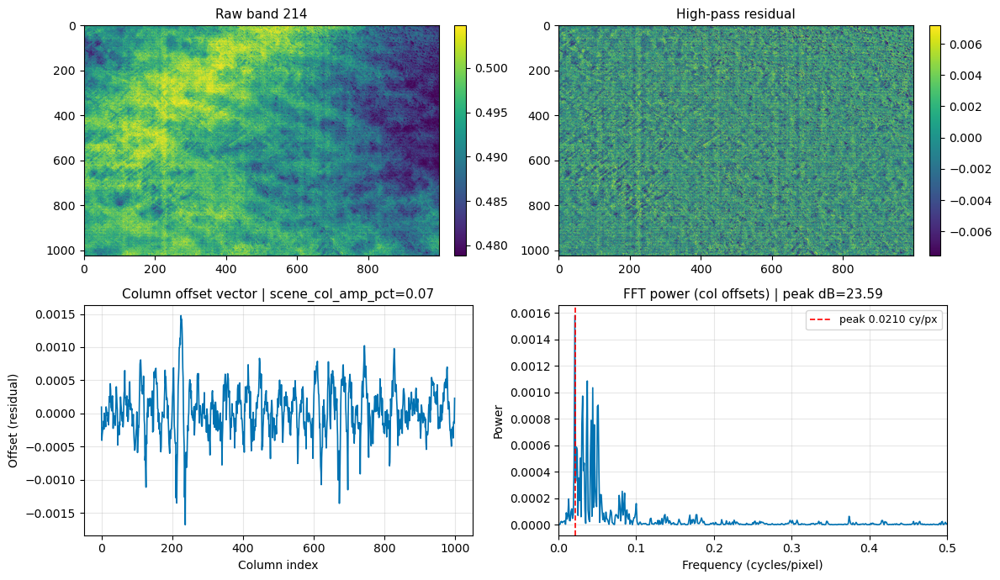

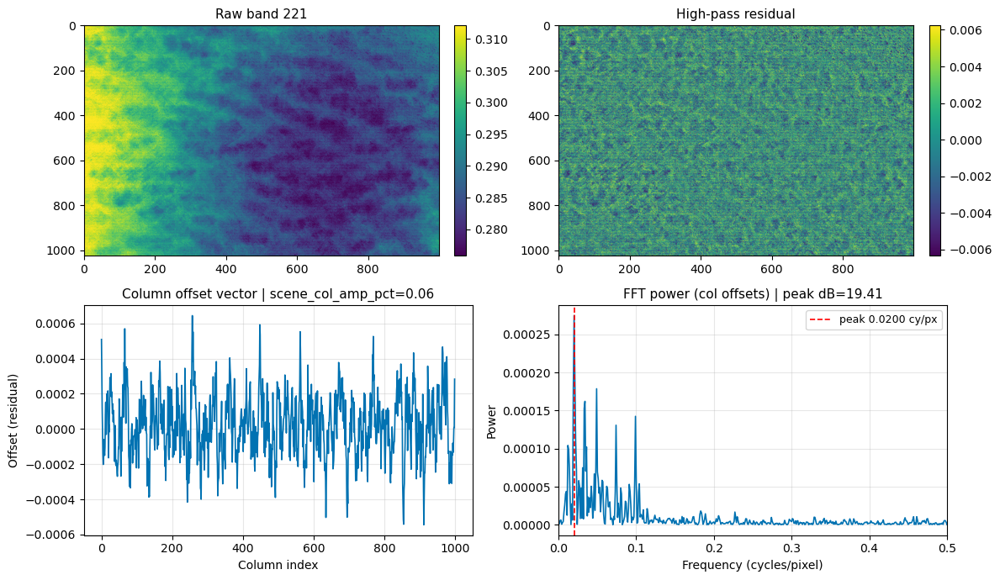

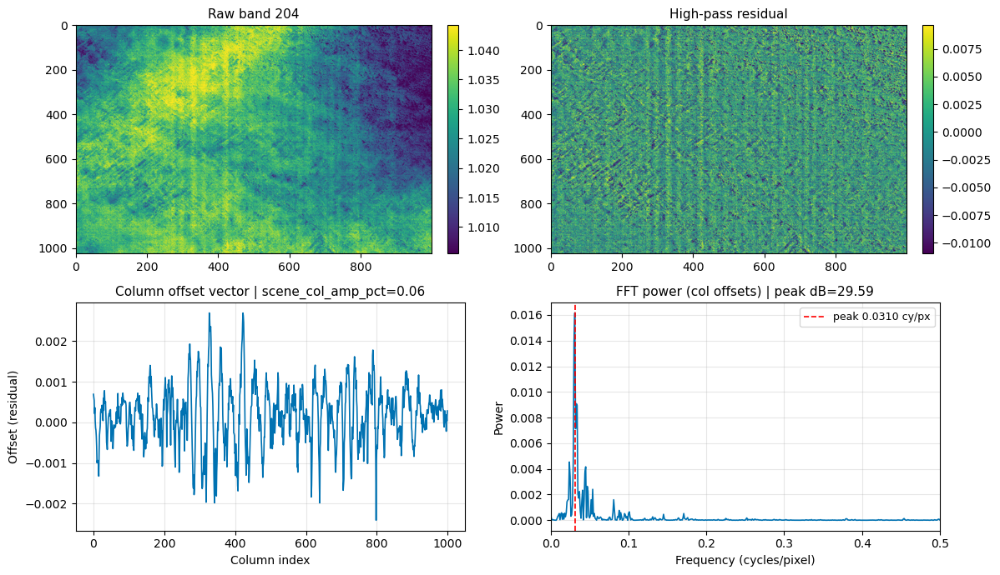

  PRISMA: worst 5 bands by scene_col_amp_pct


,band_nm,scene_col_amp_pct,fft_col_peak_db,fft_col_energy_ratio,ratio_col_amp_pct
405,2442.073563,0.410531,14.860392,0.070609,0.345984
403,2420.907729,0.330929,14.581341,0.052445,0.282983
404,2428.329525,0.305641,15.332378,0.090227,0.301223
401,2399.733973,0.304159,16.954138,0.109576,0.270595
402,2407.242149,0.296481,13.305511,0.031582,0.296914


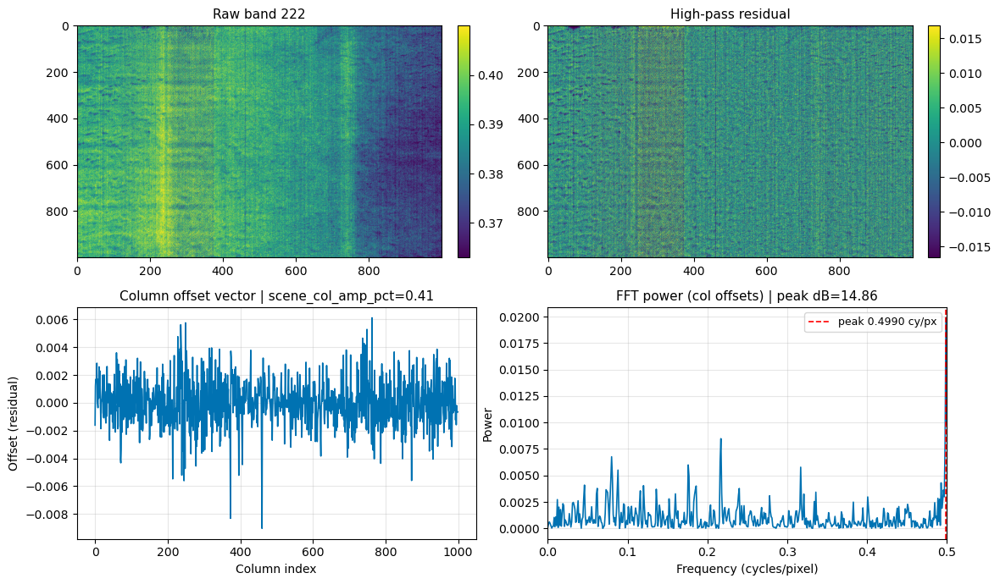

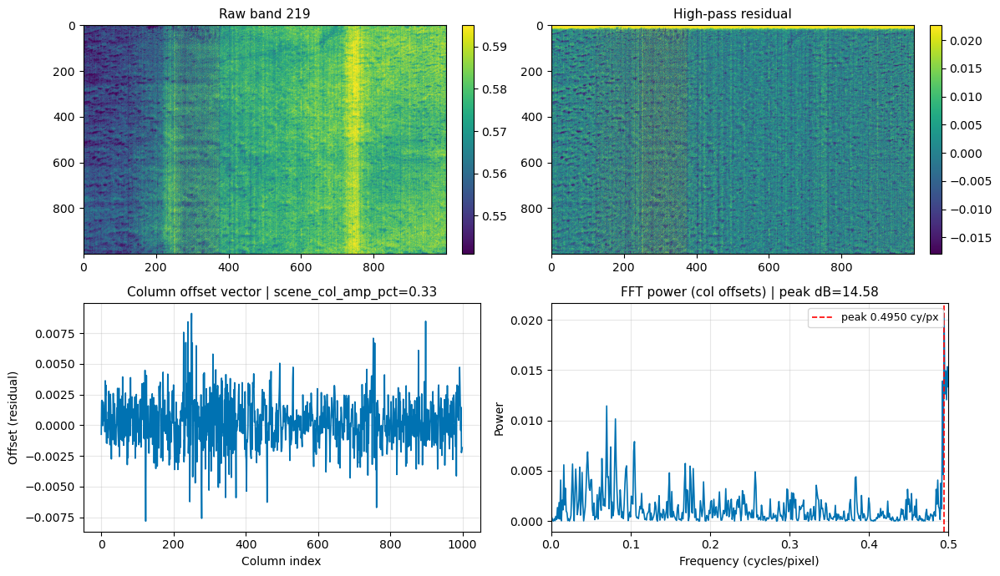

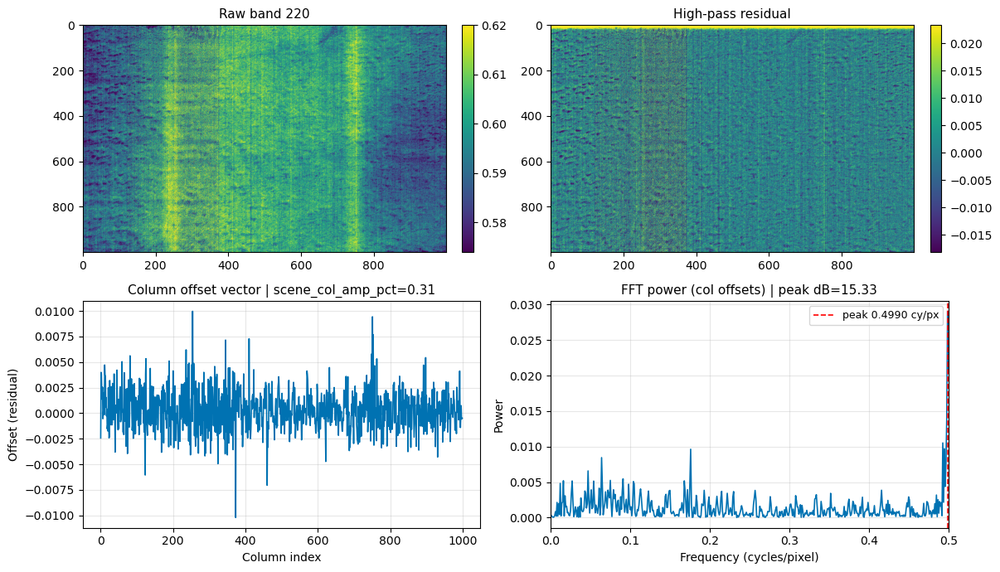

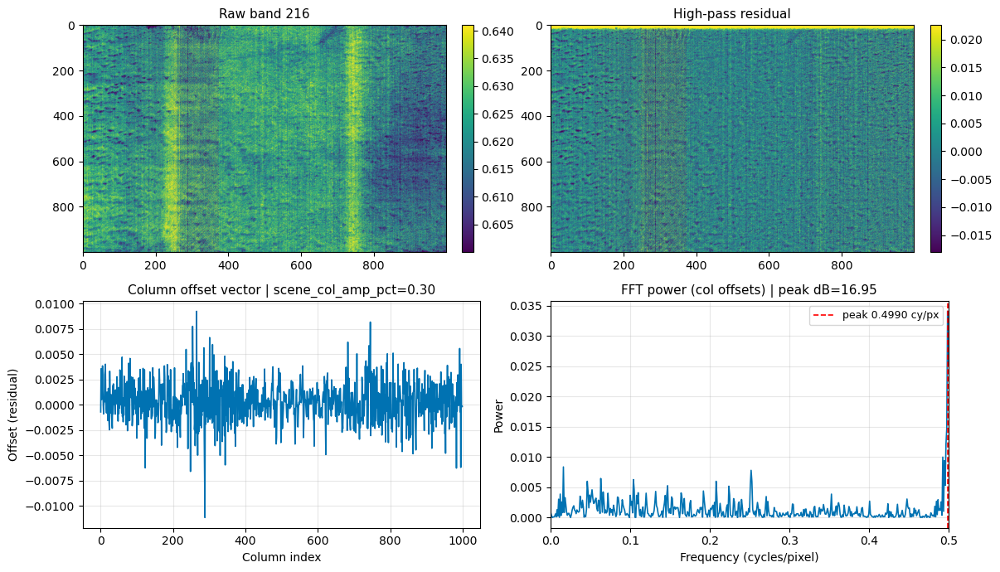

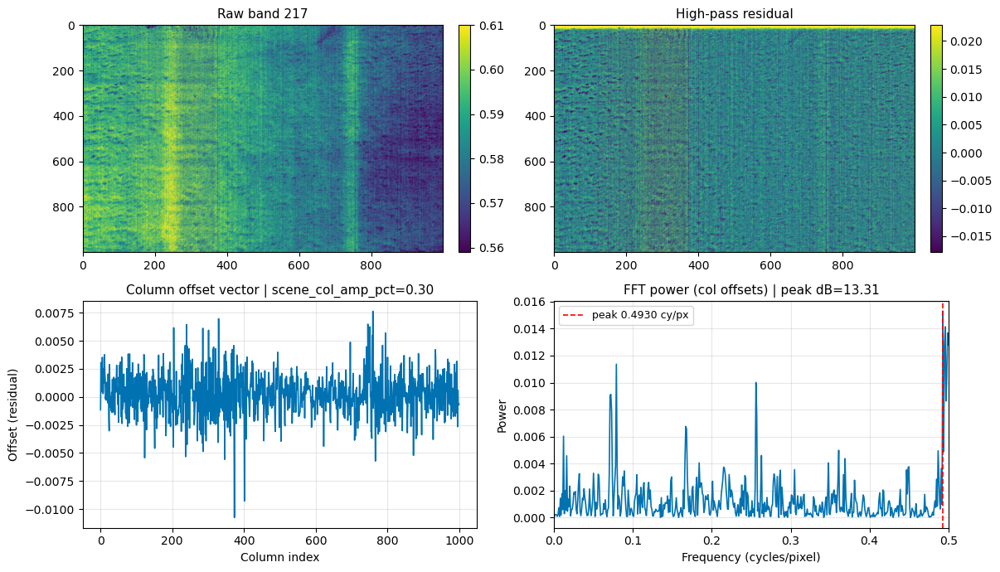

In [20]:
from IPython.display import display

def plot_worst_bands_in_windows(striping_df: pd.DataFrame, scenes: Dict[str, Dict[str, Any]], windows: dict, metric: str = "scene_col_amp_pct", n: int = 5):
    for label, (lo, hi) in windows.items():
        print(f"{label}: {lo:.0f}-{hi:.0f} nm")
        sub = striping_df[(striping_df["band_nm"] >= lo) & (striping_df["band_nm"] <= hi)]
        if sub.empty:
            print("  No bands in window.")
            continue
        for sensor, grp in sub.groupby("sensor"):
            if metric not in grp.columns:
                print(f"  {sensor}: metric {metric} missing")
                continue
            worst = grp.dropna(subset=[metric]).sort_values(metric, ascending=False).head(n)
            roi_spec = SCENE_CONFIG[sensor.lower()].get("striping_roi")
            scene = scenes[sensor.lower()]
            print(f"  {sensor}: worst {len(worst)} bands by {metric}")
            display(worst[["band_nm", metric, "fft_col_peak_db", "fft_col_energy_ratio", "ratio_col_amp_pct"]])
            for _, row in worst.iterrows():
                inspect_band(scene, int(row["band_index"]) - 1, roi_spec, metric_label=f"{metric}={row[metric]:.2f}")

# reuse scene-based metric by default
plot_worst_bands_in_windows(striping_df, {"prisma": prisma_scene, "enmap": enmap_scene}, CH4_WINDOWS, metric="scene_col_amp_pct", n=5)


## Export results
Save per-band metrics, summaries, and worst-band listings for citation and reuse.

In [21]:
from datetime import datetime
import json

TABLE_DIR.mkdir(parents=True, exist_ok=True)
PAPER_FIG_DIR.mkdir(parents=True, exist_ok=True)
scene_tag = SCENE_SET
stamp = datetime.utcnow().strftime('%Y%m%dT%H%M%SZ')

# per-band metrics
full_csv = TABLE_DIR / f"striping_metrics_{scene_tag}_{stamp}.csv"
striping_df.to_csv(full_csv, index=False)
print(f"Saved per-band metrics to {full_csv}")

# summaries
summary_overall_path = TABLE_DIR / f"summary_overall_{scene_tag}_{stamp}.csv"
summary_by_window_path = TABLE_DIR / f"summary_by_window_{scene_tag}_{stamp}.csv"
qc_overall_path = TABLE_DIR / f"qc_overall_{scene_tag}_{stamp}.csv"
qc_by_window_path = TABLE_DIR / f"qc_by_window_{scene_tag}_{stamp}.csv"
summary_overall.to_csv(summary_overall_path, index=False)
summary_by_window.to_csv(summary_by_window_path, index=False)
qc_overall.to_csv(qc_overall_path, index=False)
qc_by_window.to_csv(qc_by_window_path, index=False)
print(f"Saved summaries to {summary_overall_path} and {summary_by_window_path}")

# window tables (paper-ready, deterministic filenames)
window_csv = TABLE_DIR / f"table_window_summary_{scene_tag}.csv"
window_md = TABLE_DIR / f"table_window_summary_{scene_tag}.md"
window_tex = TABLE_DIR / f"table_window_summary_{scene_tag}.tex"
summary_by_window.to_csv(window_csv, index=False)
summary_by_window.to_markdown(window_md, index=False)
summary_by_window.to_latex(window_tex, index=False, float_format=lambda x: f"{x:.3g}")
print(f"Saved window tables to {window_csv}, {window_md}, {window_tex}")

# worst bands by window
worst_by_window = worst_bands_by_window(striping_df_windows, ["scene_col_amp_pct", "ratio_col_amp_pct", "fft_col_peak_db", "fft_col_energy_ratio"], n=3)
worst_csv = TABLE_DIR / f"table_worst_bands_by_window_{scene_tag}.csv"
worst_md = TABLE_DIR / f"table_worst_bands_by_window_{scene_tag}.md"
worst_tex = TABLE_DIR / f"table_worst_bands_by_window_{scene_tag}.tex"
worsTbl = worst_bands_by_window
worst_by_window.to_csv(worst_csv, index=False)
worst_by_window.to_markdown(worst_md, index=False)
worst_by_window.to_latex(worst_tex, index=False, float_format=lambda x: f"{x:.3g}")
print(f"Saved worst-band tables to {worst_csv}")

# prisma defective columns supplemental
prisma_def = striping_df[striping_df["sensor"]=="PRISMA"].sort_values("col_outlier_max_run_z6", ascending=False).head(10)
def_csv = TABLE_DIR / f"table_prisma_defective_columns_{scene_tag}.csv"
def_md = TABLE_DIR / f"table_prisma_defective_columns_{scene_tag}.md"
def_tex = TABLE_DIR / f"table_prisma_defective_columns_{scene_tag}.tex"
prisma_def.to_csv(def_csv, index=False)
prisma_def.to_markdown(def_md, index=False)
prisma_def.to_latex(def_tex, index=False, float_format=lambda x: f"{x:.3g}")
print(f"Saved defective-column table to {def_csv}")

# copy run config to paper figs dir
try:
    with open(RUN_CONFIG_PATH, "r") as f:
        cfg_loaded = json.load(f)
    with open(PAPER_FIG_DIR / "run_config_used.json", "w") as f:
        json.dump(cfg_loaded, f, indent=2, sort_keys=True)
    print(f"Saved run config copy to {PAPER_FIG_DIR / 'run_config_used.json'}")
except Exception as exc:
    print(f"Run config copy skipped: {exc}")

# markdown summary export with timestamp
md_path = TABLE_DIR / f"summary_by_window_{scene_tag}_{stamp}.md"
try:
    with open(md_path, "w") as f:
        f.write(summary_by_window.to_markdown(index=False))
    print(f"Saved markdown summary to {md_path}")
except Exception as exc:
    print(f"Markdown export skipped: {exc}")


Saved per-band metrics to /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs_cal_scenes/striping_metrics_cal_20251222T220820Z.csv
Saved summaries to /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs_cal_scenes/summary_overall_cal_20251222T220820Z.csv and /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs_cal_scenes/summary_by_window_cal_20251222T220820Z.csv
Saved window tables to /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs_cal_scenes/table_window_summary_cal.csv, /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs_cal_scenes/table_window_summary_cal.md, /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs_cal_scenes/table_window_summ

Notes
- `STRIPE_TARGET_MODE="grid"` with `GRID_STEP_NM=10` sweeps densely; switch to `"manual"` to match anchor wavelengths.
- `MAX_RATIO_DWL_NM` guards ratio metrics; large band gaps yield NaN ratios. Row metrics can be toggled via `COMPUTE_ROW_METRICS`.
- Use `EDGE_CROP_COLS` or `striping_roi` to isolate clean detector regions if needed.
- Low-signal bands and low valid fractions are masked to NaN to avoid spurious peaks.
- Export cell saves `striping_df` for downstream comparison/reporting.


## Paper figures (Section 4.4)

Saved /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs/paper_figs/cal/Fig_4_4_1_stripingsummary_cal.png/.pdf


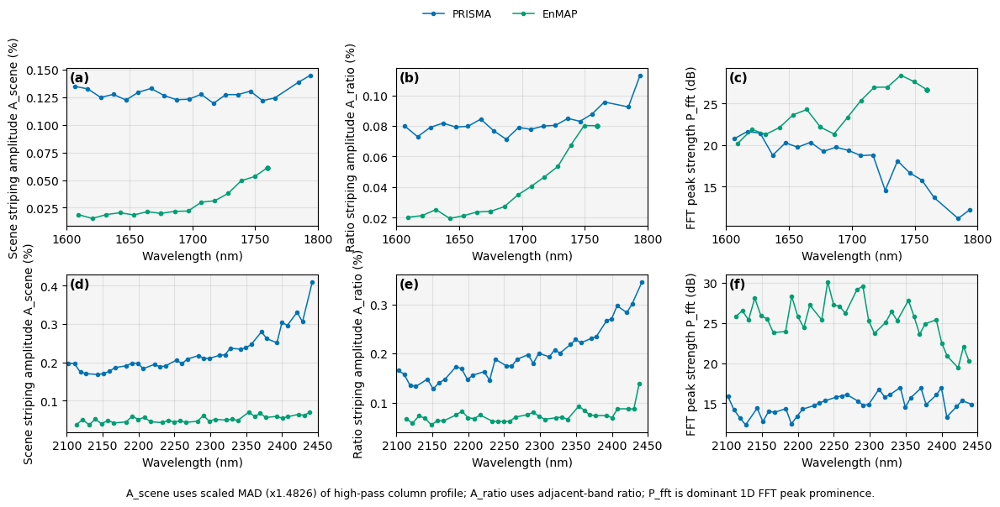

In [22]:

# Figure 4.4 striping summary
windows_fig = {
    'CH4-1.65 (1600-1800 nm)': (1600.0, 1800.0),
    'CH4-2.3 (2100-2450 nm)': (2100.0, 2450.0),
}
metrics = [
    ('scene_col_amp_pct', 'Scene striping amplitude A_scene (%)'),
    ('ratio_col_amp_pct', 'Ratio striping amplitude A_ratio (%)'),
    ('fft_col_peak_db', 'FFT peak strength P_fft (dB)'),
]
panel_labels = ['a','b','c','d','e','f']
fig, axes = plt.subplots(len(windows_fig), len(metrics), figsize=(12, 6), sharey=False)
legend_handles = {}
for r, (wlabel, (lo, hi)) in enumerate(windows_fig.items()):
    sub = striping_df[(striping_df['band_nm'] >= lo) & (striping_df['band_nm'] <= hi)]
    for c, (metric, ylabel) in enumerate(metrics):
        ax = axes[r][c] if axes.ndim == 2 else axes[c]
        for sensor_key, sensor_label in [('prisma','PRISMA'), ('enmap','EnMAP')]:
            grp = sub[sub['sensor'].str.lower() == sensor_key].sort_values('band_nm')
            if grp.empty or metric not in grp.columns:
                continue
            line, = ax.plot(grp['band_nm'], grp[metric], marker='o', ms=3, lw=1.1, label=sensor_label)
            legend_handles[sensor_label] = line
        ax.axvspan(lo, hi, color='gray', alpha=0.08)
        ax.set_xlim(lo, hi)
        ax.set_xlabel('Wavelength (nm)')
        ax.set_ylabel(ylabel)
        ax.grid(alpha=0.3)
        add_panel_label(ax, f"({panel_labels[r*len(metrics)+c]})")
fig.tight_layout(rect=(0, 0.05, 1, 0.9))
if legend_handles:
    fig.legend(legend_handles.values(), legend_handles.keys(), loc='upper center', ncol=2, frameon=False)
fig.text(0.5, 0.02, 'A_scene uses scaled MAD (x1.4826) of high-pass column profile; A_ratio uses adjacent-band ratio; P_fft is dominant 1D FFT peak prominence.', ha='center', fontsize=9)
if PAPER_FIGURES and SAVE_FIGURES:
    base = PAPER_FIG_DIR / ('Fig_4_4_1_stripingsummary_cal' if SCENE_SET.lower().startswith('cal') else 'Fig_4_4_2_stripingsummary_turk')
    save_paper_fig(fig, base)
plt.show()


Saved /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs/paper_figs/cal/Fig_S_4_4_ratio_maps_cal_1p65.png/.pdf


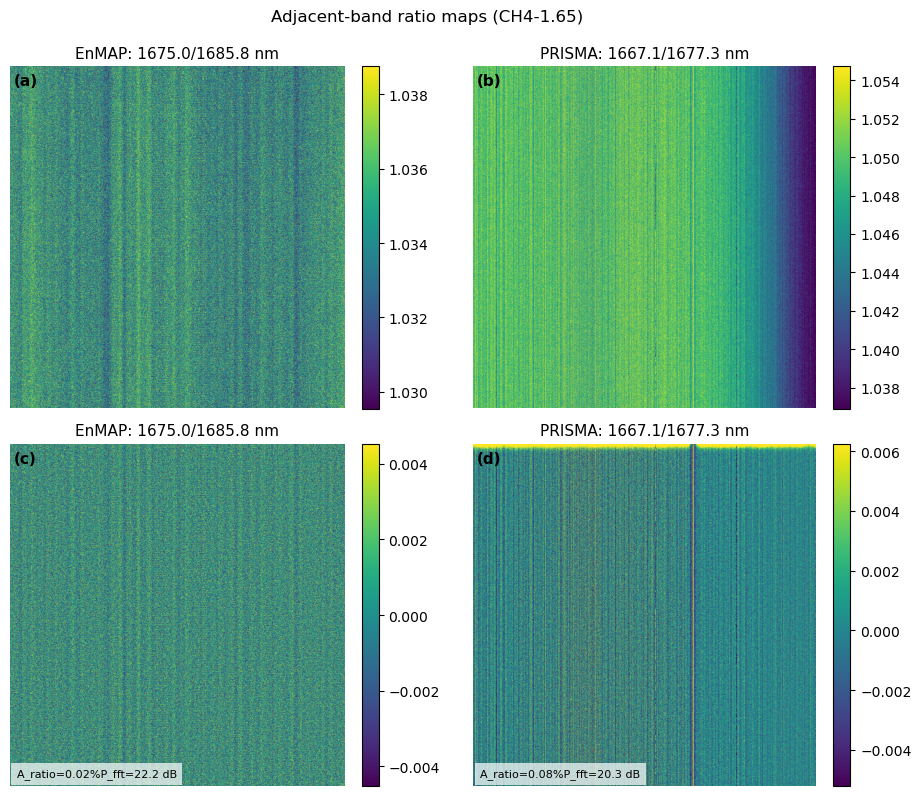

Saved /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs/paper_figs/cal/Fig_S_4_4_ratio_maps_cal_2p3.png/.pdf


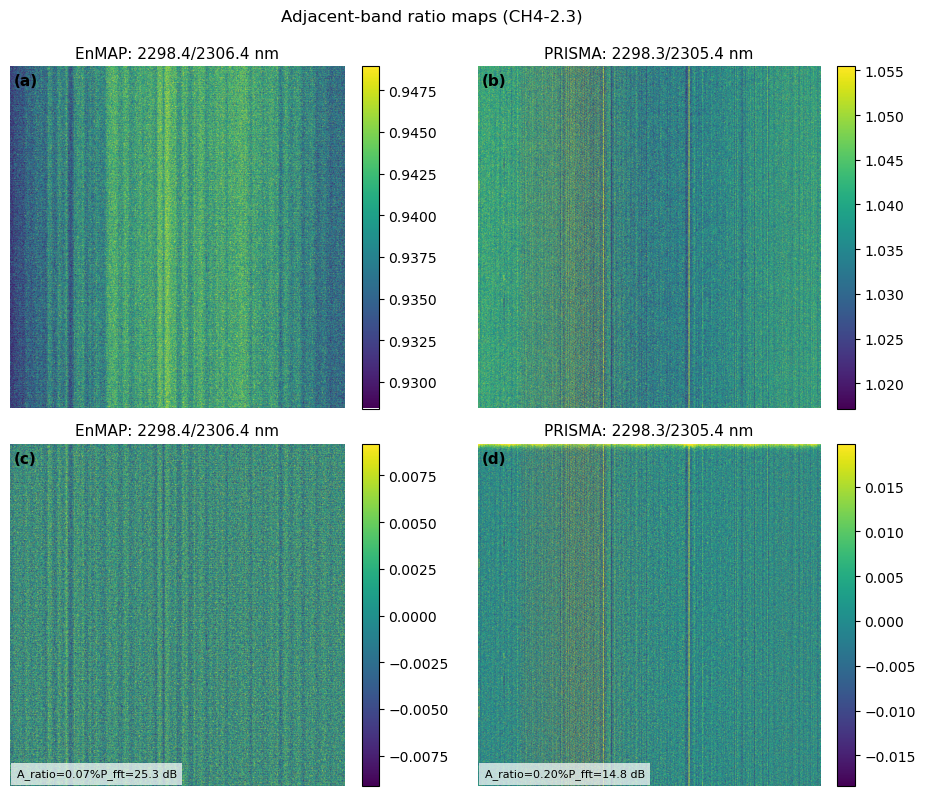

In [24]:

# Adjacent-band ratio maps (calibration scenes) – per window, per sensor
windows_ratio = [
    ('CH4-1.65', 1670.0),
    ('CH4-2.3', 2300.0),
]
sensors = [('enmap','EnMAP'), ('prisma','PRISMA')]
panel_labels = ['a','b']

for win_label, center_nm in windows_ratio:
    fig, axes = plt.subplots(2, 2, figsize=(10, 8))
    for col, (sensor_key, sensor_label) in enumerate(sensors):
        scene = {'enmap': enmap_scene, 'prisma': prisma_scene}[sensor_key]
        wl = scene['wavelengths']
        # pick band nearest center and adjacent neighbor
        idx_center = int(np.nanargmin(np.abs(wl - center_nm)))
        b_adj = idx_center + 1 if idx_center + 1 < wl.size else idx_center - 1
        wl_label = f"{wl[idx_center]:.1f}/{wl[b_adj]:.1f} nm"
        roi_spec = SCENE_CONFIG[sensor_key].get('striping_roi')
        img = apply_roi_and_crop(scene['cube_brc'][idx_center].astype(float), roi_spec, EDGE_CROP_COLS)
        img_adj = apply_roi_and_crop(scene['cube_brc'][b_adj].astype(float), roi_spec, EDGE_CROP_COLS)
        ratio = img / np.clip(img_adj, RATIO_EPS, None)
        ratio_resid = highpass(ratio)
        # per-panel color limits (no shared limits across sensors)
        for r, arr in enumerate([ratio, ratio_resid]):
            ax = axes[r][col]
            vals = arr[np.isfinite(arr)]
            vmin, vmax = (None, None)
            if vals.size:
                vmin, vmax = np.percentile(vals, [2, 98])
            im = ax.imshow(arr, cmap='viridis', vmin=vmin, vmax=vmax)
            ax.set_title(f"{sensor_label}: {wl_label}")
            ax.axis('off')
            add_panel_label(ax, f"({panel_labels[col] if r==0 else panel_labels[col].replace('a','c').replace('b','d')})")
            if im is not None:
                fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
        # metrics from nearest band
        sub = striping_df[(striping_df['sensor'].str.lower() == sensor_key)]
        if not sub.empty:
            nearest = sub.iloc[(sub['band_nm'] - wl[idx_center]).abs().argsort()[:1]]
            a_val = float(nearest['ratio_col_amp_pct'].iloc[0])
            p_val = float(nearest['fft_col_peak_db'].iloc[0]) if 'fft_col_peak_db' in nearest else float('nan')
        else:
            a_val = float('nan')
            p_val = float('nan')
        axes[1][col].text(0.02, 0.02, f"A_ratio={a_val:.2f}%P_fft={p_val:.1f} dB", transform=axes[1][col].transAxes, fontsize=8, va='bottom', ha='left', bbox=dict(facecolor='white', alpha=0.7, edgecolor='none'))
    fig.suptitle(f"Adjacent-band ratio maps ({win_label})", y=0.99)
    fig.tight_layout()
    if PAPER_FIGURES and SAVE_FIGURES:
        base = PAPER_FIG_DIR / f"Fig_S_4_4_ratio_maps_cal_{win_label.replace('CH4-','').replace('.','p')}"
        save_paper_fig(fig, base)
    plt.show()
